# Introduction

This notebook walks the reader through a full implementation of the original Neural Radiance Field architecture, first introduced by Mildenhall et al. in "[NeRF: Representing Scenes as Neural Radiance Fields for View Synthesis.](https://www.matthewtancik.com/nerf)" For a broader overview, read the accompanying Medium article "[It's NeRF From Nothing: Build A Complete NeRF With Pytorch.](https://medium.com/@masonmcgough/its-nerf-from-nothing-build-a-vanilla-nerf-with-pytorch-7846e4c45666)" This notebook assumes that you have read that article and understand the basics of NeRF.

Much of the code comes from or is inspired by the original implementation by GitHub user [bmild](https://github.com/bmild/nerf) as well as PyTorch implementations from GitHub users [yenchenlin](https://github.com/bmild/nerf) and [krrish94](https://github.com/krrish94/nerf-pytorch/). The code has been modified for clarity and consistency.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

drive_basedir = '/content/drive/MyDrive/NeRF/originalPro8Layers100k/'
tiny_nerf_data = '/content/drive/MyDrive/NeRF/tiny_nerf_data.npz'

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Imports

In [ ]:
from psutil import virtual_memory

gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)


ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

Fri Apr 26 22:44:06 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off | 00000000:00:04.0 Off |                    0 |
| N/A   31C    P0              44W / 400W |      2MiB / 40960MiB |      0%      Default |
|                                         |                      |             Disabled |
+-----------------------------------------+----------------------+--

In [ ]:
import os
from typing import Optional, Tuple, List, Union, Callable

import numpy as np
import torch
from torch import nn
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import axes3d
from tqdm import trange

# For repeatability
seed = 3407
torch.manual_seed(seed)
np.random.seed(seed)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


## Data

First we load the data which we will train our NeRF model on. This is the Lego bulldozer commonly seen in the NeRF demonstrations and serves as a sort of "Hello World" for training NeRFs. Covering other datasets is outside the scope of this notebook, but feel free to try others included in the original [NeRF source code](https://github.com/bmild/nerf) or your own datasets.

In [ ]:
if not os.path.exists(tiny_nerf_data):
  !wget --no-check-certificate http://cseweb.ucsd.edu/~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz
  !cp tiny_nerf_data.npz /content/drive/MyDrive/NeRF/tiny_nerf_data.npz

This dataset consists of 106 images taken of the synthetic Lego bulldozer along with poses and a common focal length value. Like the original, we reserve the first 100 images for training and a single test image for validation.

Images shape: (106, 100, 100, 3)
Poses shape: (106, 4, 4)
Focal length: 138.88887889922103
Pose
[[ 6.8935126e-01  5.3373039e-01 -4.8982298e-01 -1.9745398e+00]
 [-7.2442728e-01  5.0788772e-01 -4.6610624e-01 -1.8789345e+00]
 [ 1.4901163e-08  6.7615211e-01  7.3676193e-01  2.9699826e+00]
 [ 0.0000000e+00  0.0000000e+00  0.0000000e+00  1.0000000e+00]]


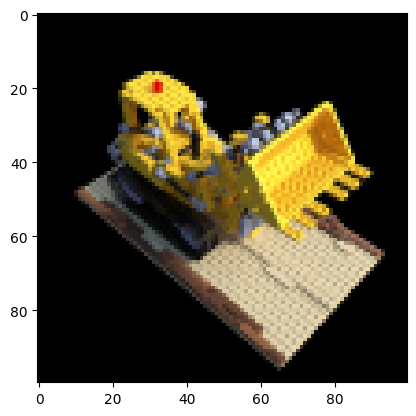

In [ ]:
data = np.load(tiny_nerf_data)
images = data['images']
poses = data['poses']
focal = data['focal']

print(f'Images shape: {images.shape}')
print(f'Poses shape: {poses.shape}')
print(f'Focal length: {focal}')

height, width = images.shape[1:3]
near, far = 2., 6.

n_training = 100
testimg_idx = 101
testimg, testpose = images[testimg_idx], poses[testimg_idx]

plt.imshow(testimg)
print('Pose')
print(testpose)

## Origins and Directions

Recall that NeRF processes inputs from a field of positions (x,y,z) and view directions (θ,φ). To gather these input points, we need to apply inverse rendering to the input images. More concretely, we draw projection lines through each pixel and across the 3D space, from which we can draw samples.

To sample points from the 3D space beyond our image, we first start from the initial pose of every camera taken in the photo set. With some vector math, we can convert these 4x4 pose matrices into a 3D coordinate denoting the origin and a 3D vector indicating the direction. The two together describe a vector that indicates where a camera was pointing when the photo was taken.

The code in the cell below illustrates this by drawing arrows that depict the origin and the direction of every frame.

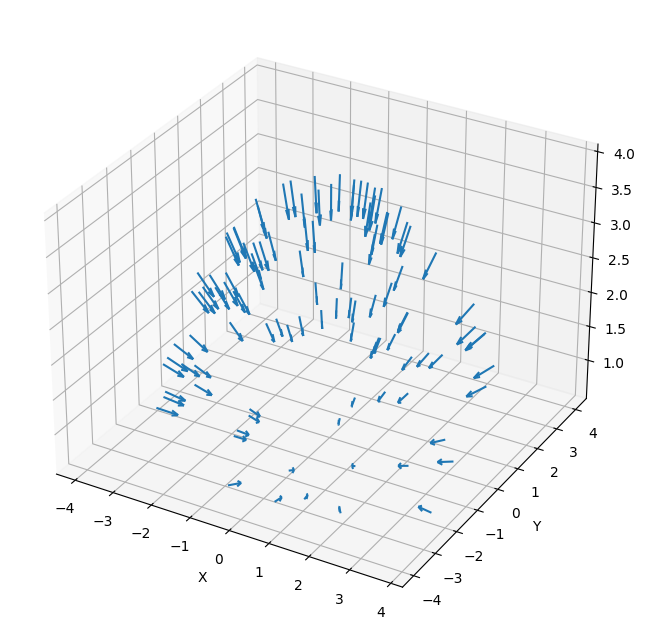

In [ ]:
dirs = np.stack([np.sum([0, 0, -1] * pose[:3, :3], axis=-1) for pose in poses])
origins = poses[:, :3, -1]

ax = plt.figure(figsize=(12, 8)).add_subplot(projection='3d')
_ = ax.quiver(
  origins[..., 0].flatten(),
  origins[..., 1].flatten(),
  origins[..., 2].flatten(),
  dirs[..., 0].flatten(),
  dirs[..., 1].flatten(),
  dirs[..., 2].flatten(), length=0.5, normalize=True)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('z')
plt.show()

With this camera pose, we can now find the projection lines along each pixel of our image. Each line is defined by its origin point (x,y,z) and its direction (in this case a 3D vector). While the origin is the same for every pixel, the direction is slightly different. These lines are slightly deflected off center such that none of these lines are parallel.

![Pinhole camera](https://www.researchgate.net/profile/Willy-Azarcoya-Cabiedes/publication/317498100/figure/fig10/AS:610418494013440@1522546518034/Pin-hole-camera-model-terminology-The-optical-center-pinhole-is-placed-at-the-origin.png)

From [Willy Azarcoya-Cabiedes via ResearchGate](https://www.researchgate.net/figure/Pin-hole-camera-model-terminology-The-optical-center-pinhole-is-placed-at-the-origin_fig10_317498100)

In [ ]:
def get_rays(
  height: int,
  width: int,
  focal_length: float,
  c2w: torch.Tensor
) -> Tuple[torch.Tensor, torch.Tensor]:
  r"""
  Find origin and direction of rays through every pixel and camera origin.
  """

  # Apply pinhole camera model to gather directions at each pixel
  i, j = torch.meshgrid(
      torch.arange(width, dtype=torch.float32).to(c2w),
      torch.arange(height, dtype=torch.float32).to(c2w),
      indexing='ij')
  i, j = i.transpose(-1, -2), j.transpose(-1, -2)
  directions = torch.stack([(i - width * .5) / focal_length,
                            -(j - height * .5) / focal_length,
                            -torch.ones_like(i)
                           ], dim=-1)

  # Apply camera pose to directions
  rays_d = torch.sum(directions[..., None, :] * c2w[:3, :3], dim=-1)

  # Origin is same for all directions (the optical center)
  rays_o = c2w[:3, -1].expand(rays_d.shape)
  return rays_o, rays_d

In [ ]:
testpose

array([[ 6.8935126e-01,  5.3373039e-01, -4.8982298e-01, -1.9745398e+00],
       [-7.2442728e-01,  5.0788772e-01, -4.6610624e-01, -1.8789345e+00],
       [ 1.4901163e-08,  6.7615211e-01,  7.3676193e-01,  2.9699826e+00],
       [ 0.0000000e+00,  0.0000000e+00,  0.0000000e+00,  1.0000000e+00]],
      dtype=float32)

In [ ]:
focal

array(138.8888789)

In [ ]:
# Gather as torch tensors
images = torch.from_numpy(data['images'][:n_training]).to(device)
poses = torch.from_numpy(data['poses']).to(device)
focal = torch.from_numpy(data['focal']).to(device)
testimg = torch.from_numpy(data['images'][testimg_idx]).to(device)
testpose = torch.from_numpy(data['poses'][testimg_idx]).to(device)

# Grab rays from sample image
height, width = images.shape[1:3]
with torch.no_grad():
  ray_origin, ray_direction = get_rays(height, width, focal, testpose)

print('Ray Origin')
print(ray_origin.shape)
print(ray_origin[height // 2, width // 2, :])
print('')

print('Ray Direction')
print(ray_direction.shape)
print(ray_direction[height // 2, width // 2, :])
print('')

Ray Origin
torch.Size([100, 100, 3])
tensor([-1.9745, -1.8789,  2.9700], device='cuda:0')

Ray Direction
torch.Size([100, 100, 3])
tensor([ 0.4898,  0.4661, -0.7368], device='cuda:0')



# Architecture

## Stratified Sampling

Now that we have these lines, defined as origin and direction vectors, we can begin the process of sampling them. Recall that NeRF takes a coarse-to-fine sampling strategy, starting with the stratified sampling approach.

The stratified sampling approach splits the ray into evenly-spaced bins and randomly samples within each bin. The `perturb` setting determines whether to sample points uniformly from each bin or to simply use the bin center as the point. In most cases, we want to keep `perturb = True` as it will encourage the network to learn over a continuously sampled space. It may be useful to disable for debugging.

In [ ]:
def sample_stratified(
  rays_o: torch.Tensor,
  rays_d: torch.Tensor,
  near: float,
  far: float,
  n_samples: int,
  perturb: Optional[bool] = True,
  inverse_depth: bool = False
) -> Tuple[torch.Tensor, torch.Tensor]:
  r"""
  Sample along ray from regularly-spaced bins.
  """

  # Grab samples for space integration along ray
  t_vals = torch.linspace(0., 1., n_samples, device=rays_o.device)
  if not inverse_depth:
    # Sample linearly between `near` and `far`
    z_vals = near * (1.-t_vals) + far * (t_vals)
  else:
    # Sample linearly in inverse depth (disparity)
    z_vals = 1./(1./near * (1.-t_vals) + 1./far * (t_vals))

  # Draw uniform samples from bins along ray
  if perturb:
    mids = .5 * (z_vals[1:] + z_vals[:-1])
    upper = torch.concat([mids, z_vals[-1:]], dim=-1)
    lower = torch.concat([z_vals[:1], mids], dim=-1)
    t_rand = torch.rand([n_samples], device=z_vals.device)
    z_vals = lower + (upper - lower) * t_rand
  z_vals = z_vals.expand(list(rays_o.shape[:-1]) + [n_samples])

  # Apply scale from `rays_d` and offset from `rays_o` to samples
  # pts: (width, height, n_samples, 3)
  pts = rays_o[..., None, :] + rays_d[..., None, :] * z_vals[..., :, None]
  return pts, z_vals

In [ ]:
# Draw stratified samples from example
rays_o = ray_origin.view([-1, 3])
rays_d = ray_direction.view([-1, 3])
n_samples = 8
perturb = True
inverse_depth = False
with torch.no_grad():
  pts, z_vals = sample_stratified(rays_o, rays_d, near, far, n_samples,
                                  perturb=perturb, inverse_depth=inverse_depth)

print('Input Points')
print(pts.shape)
print('')
print('Distances Along Ray')
print(z_vals.shape)

Input Points
torch.Size([10000, 8, 3])

Distances Along Ray
torch.Size([10000, 8])


Now we visualize these sampled points. The unperturbed blue points are the bin "centers." The red points are a sampling of perturbed points. Notice how the red points are slightly offset from the blue points above them, but all are constrained between `near` and `far`.

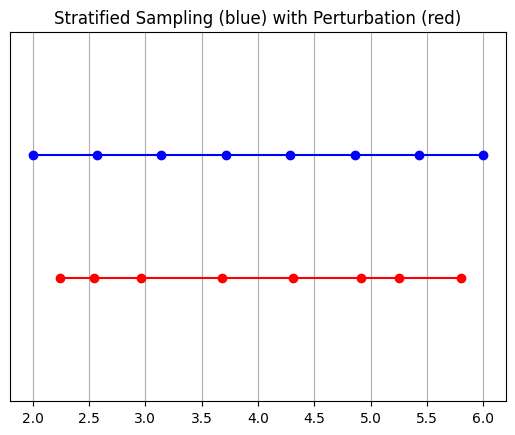

In [ ]:
y_vals = torch.zeros_like(z_vals)

_, z_vals_unperturbed = sample_stratified(rays_o, rays_d, near, far, n_samples,
                                  perturb=False, inverse_depth=inverse_depth)
plt.plot(z_vals_unperturbed[0].cpu().numpy(), 1 + y_vals[0].cpu().numpy(), 'b-o')
plt.plot(z_vals[0].cpu().numpy(), y_vals[0].cpu().numpy(), 'r-o')
plt.ylim([-1, 2])
plt.title('Stratified Sampling (blue) with Perturbation (red)')
ax = plt.gca()
ax.axes.yaxis.set_visible(False)
plt.grid(True)

## Positional Encoder

Much like Transformers, NeRFs make use of positional encoders. In this case, it's to map the inputs to a higher frequency space to compensate for the bias that neural networks have for learning lower-frequency functions.

Here we build a simple `torch.nn.Module` of our positional encoder. The same encoder implementation can be applied to both input samples and view directions. However, we choose different parameters for these inputs. We use the default settings from the original.

In [ ]:
class PositionalEncoder(nn.Module):
  r"""
  Sine-cosine positional encoder for input points.
  """
  def __init__(
    self,
    d_input: int,
    n_freqs: int,
    log_space: bool = False
  ):
    super().__init__()
    self.d_input = d_input
    self.n_freqs = n_freqs
    self.log_space = log_space
    self.d_output = d_input * (1 + 2 * self.n_freqs)
    self.embed_fns = [lambda x: x]

    # Define frequencies in either linear or log scale
    if self.log_space:
      freq_bands = 2.**torch.linspace(0., self.n_freqs - 1, self.n_freqs)
    else:
      freq_bands = torch.linspace(2.**0., 2.**(self.n_freqs - 1), self.n_freqs)

    # Alternate sin and cos
    for freq in freq_bands:
      self.embed_fns.append(lambda x, freq=freq: torch.sin(x * freq))
      self.embed_fns.append(lambda x, freq=freq: torch.cos(x * freq))

  def forward(
    self,
    x
  ) -> torch.Tensor:
    r"""
    Apply positional encoding to input.
    """
    return torch.concat([fn(x) for fn in self.embed_fns], dim=-1)


In [ ]:
# Create encoders for points and view directions
encoder = PositionalEncoder(3, 10)
viewdirs_encoder = PositionalEncoder(3, 4)

# Grab flattened points and view directions
pts_flattened = pts.reshape(-1, 3)
viewdirs = rays_d / torch.norm(rays_d, dim=-1, keepdim=True)
flattened_viewdirs = viewdirs[:, None, ...].expand(pts.shape).reshape((-1, 3))

# Encode inputs
encoded_points = encoder(pts_flattened)
encoded_viewdirs = viewdirs_encoder(flattened_viewdirs)

print('Encoded Points')
print(encoded_points.shape)
print(torch.min(encoded_points), torch.max(encoded_points), torch.mean(encoded_points))
print('')

print(encoded_viewdirs.shape)
print('Encoded Viewdirs')
print(torch.min(encoded_viewdirs), torch.max(encoded_viewdirs), torch.mean(encoded_viewdirs))
print('')

Encoded Points
torch.Size([80000, 63])
tensor(-2.6900, device='cuda:0') tensor(3.4005, device='cuda:0') tensor(0.0273, device='cuda:0')

torch.Size([80000, 27])
Encoded Viewdirs
tensor(-1., device='cuda:0') tensor(1., device='cuda:0') tensor(0.1056, device='cuda:0')



## NeRF Model

Here we define the NeRF model, which consists primarily of a `ModuleList` of `Linear` layers, separated by non-linear activation functions and the occasional residual connection. This model features an optional input for view directions, which will alter the model architecture if provided at instantiation. This implementation is based on Section 3 of the original "NeRF: Representing Scenes as Neural Radiance Fields for View Synthesis" paper and uses the same defaults.

In [ ]:
class NeRF(nn.Module):
  r"""
  Neural radiance fields module.
  """
  def __init__(
    self,
    d_input: int = 3,
    n_layers: int = 8,
    d_filter: int = 256,
    skip: Tuple[int] = (4,),
    d_viewdirs: Optional[int] = None
  ):
    super().__init__()
    self.d_input = d_input
    self.skip = skip
    self.act = nn.functional.relu
    self.d_viewdirs = d_viewdirs

    # Create model layers
    self.layers = nn.ModuleList(
      [nn.Linear(self.d_input, d_filter)] +
      [nn.Linear(d_filter + self.d_input, d_filter) if i in skip \
       else nn.Linear(d_filter, d_filter) for i in range(n_layers - 1)]
    )

    # Bottleneck layers
    if self.d_viewdirs is not None:
      # If using viewdirs, split alpha and RGB
      self.alpha_out = nn.Linear(d_filter, 1)
      self.rgb_filters = nn.Linear(d_filter, d_filter)
      self.branch = nn.Linear(d_filter + self.d_viewdirs, d_filter // 2)
      self.output = nn.Linear(d_filter // 2, 3)
    else:
      # If no viewdirs, use simpler output
      self.output = nn.Linear(d_filter, 4)

  def forward(
    self,
    x: torch.Tensor,
    viewdirs: Optional[torch.Tensor] = None
  ) -> torch.Tensor:
    r"""
    Forward pass with optional view direction.
    """

    # Cannot use viewdirs if instantiated with d_viewdirs = None
    if self.d_viewdirs is None and viewdirs is not None:
      raise ValueError('Cannot input x_direction if d_viewdirs was not given.')

    # Apply forward pass up to bottleneck
    x_input = x
    for i, layer in enumerate(self.layers):
      x = self.act(layer(x))
      if i in self.skip:
        x = torch.cat([x, x_input], dim=-1)

    # Apply bottleneck
    if self.d_viewdirs is not None:
      # Split alpha from network output
      alpha = self.alpha_out(x)

      # Pass through bottleneck to get RGB
      x = self.rgb_filters(x)
      x = torch.concat([x, viewdirs], dim=-1)
      x = self.act(self.branch(x))
      x = self.output(x)

      # Concatenate alphas to output
      x = torch.concat([x, alpha], dim=-1)
    else:
      # Simple output
      x = self.output(x)
    return x

## Volume Rendering

From the raw NeRF outputs, we still need to convert these into an image. This is where we apply the volume integration described in Equations 1-3 in Section 4 of the paper. Essentially, we take the weighted sum of all samples along the ray of each pixel to get the estimated color value at that pixel. Each RGB sample is weighted by its alpha value. Higher alpha values indicate higher likelihood that the sampled area is opaque, therefore points further along the ray are likelier to be occluded. The cumulative product ensures that those further points are dampened.

In [ ]:
def cumprod_exclusive(
  tensor: torch.Tensor
) -> torch.Tensor:
  r"""
  (Courtesy of https://github.com/krrish94/nerf-pytorch)

  Mimick functionality of tf.math.cumprod(..., exclusive=True), as it isn't available in PyTorch.

  Args:
  tensor (torch.Tensor): Tensor whose cumprod (cumulative product, see `torch.cumprod`) along dim=-1
    is to be computed.
  Returns:
  cumprod (torch.Tensor): cumprod of Tensor along dim=-1, mimiciking the functionality of
    tf.math.cumprod(..., exclusive=True) (see `tf.math.cumprod` for details).
  """

  # Compute regular cumprod first (this is equivalent to `tf.math.cumprod(..., exclusive=False)`).
  cumprod = torch.cumprod(tensor, -1)
  # "Roll" the elements along dimension 'dim' by 1 element.
  cumprod = torch.roll(cumprod, 1, -1)
  # Replace the first element by "1" as this is what tf.cumprod(..., exclusive=True) does.
  cumprod[..., 0] = 1.

  return cumprod

def raw2outputs(
  raw: torch.Tensor,
  z_vals: torch.Tensor,
  rays_d: torch.Tensor,
  raw_noise_std: float = 0.0,
  white_bkgd: bool = False
) -> Tuple[torch.Tensor, torch.Tensor, torch.Tensor, torch.Tensor]:
  r"""
  Convert the raw NeRF output into RGB and other maps.
  """

  # Difference between consecutive elements of `z_vals`. [n_rays, n_samples]
  dists = z_vals[..., 1:] - z_vals[..., :-1]
  dists = torch.cat([dists, 1e10 * torch.ones_like(dists[..., :1])], dim=-1)

  # Multiply each distance by the norm of its corresponding direction ray
  # to convert to real world distance (accounts for non-unit directions).
  dists = dists * torch.norm(rays_d[..., None, :], dim=-1)

  # Add noise to model's predictions for density. Can be used to
  # regularize network during training (prevents floater artifacts).
  noise = 0.
  if raw_noise_std > 0.:
    noise = torch.randn(raw[..., 3].shape) * raw_noise_std

  # Predict density of each sample along each ray. Higher values imply
  # higher likelihood of being absorbed at this point. [n_rays, n_samples]
  alpha = 1.0 - torch.exp(-nn.functional.relu(raw[..., 3] + noise) * dists)

  # Compute weight for RGB of each sample along each ray. [n_rays, n_samples]
  # The higher the alpha, the lower subsequent weights are driven.
  weights = alpha * cumprod_exclusive(1. - alpha + 1e-10)

  # Compute weighted RGB map.
  rgb = torch.sigmoid(raw[..., :3])  # [n_rays, n_samples, 3]
  rgb_map = torch.sum(weights[..., None] * rgb, dim=-2)  # [n_rays, 3]

  # Estimated depth map is predicted distance.
  depth_map = torch.sum(weights * z_vals, dim=-1)

  # Disparity map is inverse depth.
  disp_map = 1. / torch.max(1e-10 * torch.ones_like(depth_map),
                            depth_map / torch.sum(weights, -1))

  # Sum of weights along each ray. In [0, 1] up to numerical error.
  acc_map = torch.sum(weights, dim=-1)

  # To composite onto a white background, use the accumulated alpha map.
  if white_bkgd:
    rgb_map = rgb_map + (1. - acc_map[..., None])

  return rgb_map, depth_map, acc_map, weights

## Hierarchical Volume Sampling

The 3D space is in fact very sparse with occlusions and so most points don't contribute much to the rendered image. It is therefore more beneficial to oversample regions with a high likelihood of contributing to the integral. Here we apply learned, normalized weights to the first set of samples to create a PDF across the ray, then apply inverse transform sampling to this PDF to gather a second set of samples.

In [ ]:
def sample_pdf(
  bins: torch.Tensor,
  weights: torch.Tensor,
  n_samples: int,
  perturb: bool = False
) -> torch.Tensor:
  r"""
  Apply inverse transform sampling to a weighted set of points.
  """

  # Normalize weights to get PDF.
  pdf = (weights + 1e-5) / torch.sum(weights + 1e-5, -1, keepdims=True) # [n_rays, weights.shape[-1]]

  # Convert PDF to CDF.
  cdf = torch.cumsum(pdf, dim=-1) # [n_rays, weights.shape[-1]]
  cdf = torch.concat([torch.zeros_like(cdf[..., :1]), cdf], dim=-1) # [n_rays, weights.shape[-1] + 1]

  # Take sample positions to grab from CDF. Linear when perturb == 0.
  if not perturb:
    u = torch.linspace(0., 1., n_samples, device=cdf.device)
    u = u.expand(list(cdf.shape[:-1]) + [n_samples]) # [n_rays, n_samples]
  else:
    u = torch.rand(list(cdf.shape[:-1]) + [n_samples], device=cdf.device) # [n_rays, n_samples]

  # Find indices along CDF where values in u would be placed.
  u = u.contiguous() # Returns contiguous tensor with same values.
  inds = torch.searchsorted(cdf, u, right=True) # [n_rays, n_samples]

  # Clamp indices that are out of bounds.
  below = torch.clamp(inds - 1, min=0)
  above = torch.clamp(inds, max=cdf.shape[-1] - 1)
  inds_g = torch.stack([below, above], dim=-1) # [n_rays, n_samples, 2]

  # Sample from cdf and the corresponding bin centers.
  matched_shape = list(inds_g.shape[:-1]) + [cdf.shape[-1]]
  cdf_g = torch.gather(cdf.unsqueeze(-2).expand(matched_shape), dim=-1,
                       index=inds_g)
  bins_g = torch.gather(bins.unsqueeze(-2).expand(matched_shape), dim=-1,
                        index=inds_g)

  # Convert samples to ray length.
  denom = (cdf_g[..., 1] - cdf_g[..., 0])
  denom = torch.where(denom < 1e-5, torch.ones_like(denom), denom)
  t = (u - cdf_g[..., 0]) / denom
  samples = bins_g[..., 0] + t * (bins_g[..., 1] - bins_g[..., 0])

  return samples # [n_rays, n_samples]

In [ ]:
def sample_hierarchical(
  rays_o: torch.Tensor,
  rays_d: torch.Tensor,
  z_vals: torch.Tensor,
  weights: torch.Tensor,
  n_samples: int,
  perturb: bool = False
) -> Tuple[torch.Tensor, torch.Tensor, torch.Tensor]:
  r"""
  Apply hierarchical sampling to the rays.
  """

  # Draw samples from PDF using z_vals as bins and weights as probabilities.
  z_vals_mid = .5 * (z_vals[..., 1:] + z_vals[..., :-1])
  new_z_samples = sample_pdf(z_vals_mid, weights[..., 1:-1], n_samples,
                          perturb=perturb)
  new_z_samples = new_z_samples.detach()

  # Resample points from ray based on PDF.
  z_vals_combined, _ = torch.sort(torch.cat([z_vals, new_z_samples], dim=-1), dim=-1)
  pts = rays_o[..., None, :] + rays_d[..., None, :] * z_vals_combined[..., :, None]  # [N_rays, N_samples + n_samples, 3]
  return pts, z_vals_combined, new_z_samples

## Full Forward Pass

Here is where we put everything together to compute a single forward pass through our model.

Due to potential memory issues, the forward pass is computed in "chunks," which are then aggregated across a single batch. The gradient propagation is done after the whole batch is processed, hence the distinction between "chunks" and "batches." Chunking is especially important for the Google Colab environment, which provides more modest resources than those cited in the original paper.

In [ ]:
def get_chunks(
  inputs: torch.Tensor,
  chunksize: int = 2**15
) -> List[torch.Tensor]:
  r"""
  Divide an input into chunks.
  """
  return [inputs[i:i + chunksize] for i in range(0, inputs.shape[0], chunksize)]

def prepare_chunks(
  points: torch.Tensor,
  encoding_function: Callable[[torch.Tensor], torch.Tensor],
  chunksize: int = 2**15
) -> List[torch.Tensor]:
  r"""
  Encode and chunkify points to prepare for NeRF model.
  """
  points = points.reshape((-1, 3))
  points = encoding_function(points)
  points = get_chunks(points, chunksize=chunksize)
  return points

def prepare_viewdirs_chunks(
  points: torch.Tensor,
  rays_d: torch.Tensor,
  encoding_function: Callable[[torch.Tensor], torch.Tensor],
  chunksize: int = 2**15
) -> List[torch.Tensor]:
  r"""
  Encode and chunkify viewdirs to prepare for NeRF model.
  """
  # Prepare the viewdirs
  viewdirs = rays_d / torch.norm(rays_d, dim=-1, keepdim=True)
  viewdirs = viewdirs[:, None, ...].expand(points.shape).reshape((-1, 3))
  viewdirs = encoding_function(viewdirs)
  viewdirs = get_chunks(viewdirs, chunksize=chunksize)
  return viewdirs

In [ ]:
def nerf_forward(
  rays_o: torch.Tensor,
  rays_d: torch.Tensor,
  near: float,
  far: float,
  encoding_fn: Callable[[torch.Tensor], torch.Tensor],
  coarse_model: nn.Module,
  kwargs_sample_stratified: dict = None,
  n_samples_hierarchical: int = 0,
  kwargs_sample_hierarchical: dict = None,
  fine_model = None,
  viewdirs_encoding_fn: Optional[Callable[[torch.Tensor], torch.Tensor]] = None,
  chunksize: int = 2**15
) -> Tuple[torch.Tensor, torch.Tensor, torch.Tensor, dict]:
  r"""
  Compute forward pass through model(s).
  """

  # Set no kwargs if none are given.
  if kwargs_sample_stratified is None:
    kwargs_sample_stratified = {}
  if kwargs_sample_hierarchical is None:
    kwargs_sample_hierarchical = {}

  # Sample query points along each ray.
  query_points, z_vals = sample_stratified(
      rays_o, rays_d, near, far, **kwargs_sample_stratified)

  # Prepare batches.
  batches = prepare_chunks(query_points, encoding_fn, chunksize=chunksize)
  if viewdirs_encoding_fn is not None:
    batches_viewdirs = prepare_viewdirs_chunks(query_points, rays_d,
                                               viewdirs_encoding_fn,
                                               chunksize=chunksize)
  else:
    batches_viewdirs = [None] * len(batches)

  # Coarse model pass.
  # Split the encoded points into "chunks", run the model on all chunks, and
  # concatenate the results (to avoid out-of-memory issues).
  predictions = []
  for batch, batch_viewdirs in zip(batches, batches_viewdirs):
    predictions.append(coarse_model(batch, viewdirs=batch_viewdirs))
  raw = torch.cat(predictions, dim=0)
  raw = raw.reshape(list(query_points.shape[:2]) + [raw.shape[-1]])

  # Perform differentiable volume rendering to re-synthesize the RGB image.
  rgb_map, depth_map, acc_map, weights = raw2outputs(raw, z_vals, rays_d)
  # rgb_map, depth_map, acc_map, weights = render_volume_density(raw, rays_o, z_vals)
  outputs = {
      'z_vals_stratified': z_vals
  }

  # Fine model pass.
  if n_samples_hierarchical > 0:
    # Save previous outputs to return.
    rgb_map_0, depth_map_0, acc_map_0 = rgb_map, depth_map, acc_map

    # Apply hierarchical sampling for fine query points.
    query_points, z_vals_combined, z_hierarch = sample_hierarchical(
      rays_o, rays_d, z_vals, weights, n_samples_hierarchical,
      **kwargs_sample_hierarchical)

    # Prepare inputs as before.
    batches = prepare_chunks(query_points, encoding_fn, chunksize=chunksize)
    if viewdirs_encoding_fn is not None:
      batches_viewdirs = prepare_viewdirs_chunks(query_points, rays_d,
                                                 viewdirs_encoding_fn,
                                                 chunksize=chunksize)
    else:
      batches_viewdirs = [None] * len(batches)

    # Forward pass new samples through fine model.
    fine_model = fine_model if fine_model is not None else coarse_model
    predictions = []
    for batch, batch_viewdirs in zip(batches, batches_viewdirs):
      predictions.append(fine_model(batch, viewdirs=batch_viewdirs))
    raw = torch.cat(predictions, dim=0)
    raw = raw.reshape(list(query_points.shape[:2]) + [raw.shape[-1]])

    # Perform differentiable volume rendering to re-synthesize the RGB image.
    rgb_map, depth_map, acc_map, weights = raw2outputs(raw, z_vals_combined, rays_d)

    # Store outputs.
    outputs['z_vals_hierarchical'] = z_hierarch
    outputs['rgb_map_0'] = rgb_map_0
    outputs['depth_map_0'] = depth_map_0
    outputs['acc_map_0'] = acc_map_0

  # Store outputs.
  outputs['rgb_map'] = rgb_map
  outputs['depth_map'] = depth_map
  outputs['acc_map'] = acc_map
  outputs['weights'] = weights
  return outputs

# Train

At long last, we have (almost) everything we need to train the model. Now we will do some setup for a simple training procedure, creating hyperparameters and helper functions, then train our model.

## Hyperparameters

All hyperparameters for training are set here. Defaults were taken from the original, unless computational constraints prohibit them. In this case, we apply sensible defaults that are well within the resources provided by Google Colab.

In [ ]:
# Encoders
d_input = 3           # Number of input dimensions
n_freqs = 10          # Number of encoding functions for samples
log_space = True      # If set, frequencies scale in log space
use_viewdirs = True   # If set, use view direction as input
n_freqs_views = 4     # Number of encoding functions for views

# Stratified sampling
n_samples = 64         # Number of spatial samples per ray
perturb = True         # If set, applies noise to sample positions
inverse_depth = False  # If set, samples points linearly in inverse depth

# Model
d_filter = 256          # Dimensions of linear layer filters
n_layers = 8            # Number of layers in network bottleneck
skip = []               # Layers at which to apply input residual
use_fine_model = True   # If set, creates a fine model
d_filter_fine = 256     # Dimensions of linear layer filters of fine network
n_layers_fine = 8       # Number of layers in fine network bottleneck

# Hierarchical sampling
n_samples_hierarchical = 64   # Number of samples per ray
perturb_hierarchical = False  # If set, applies noise to sample positions

# Optimizer
lr = 5e-4  # Learning rate

# Training
n_iters = 30000
batch_size = 2**14          # Number of rays per gradient step (power of 2)
one_image_per_step = True   # One image per gradient step (disables batching)
chunksize = 2**14           # Modify as needed to fit in GPU memory
center_crop = True          # Crop the center of image (one_image_per_)
center_crop_iters = 50      # Stop cropping center after this many epochs
display_rate = 25           # Display test output every X epochs

# Early Stopping
warmup_iters = 100          # Number of iterations during warmup phase
warmup_min_fitness = 10.0   # Min val PSNR to continue training at warmup_iters
n_restarts = 10             # Number of times to restart if training stalls

# We bundle the kwargs for various functions to pass all at once.
kwargs_sample_stratified = {
    'n_samples': n_samples,
    'perturb': perturb,
    'inverse_depth': inverse_depth
}
kwargs_sample_hierarchical = {
    'perturb': perturb
}

## Training Classes and Functions

Here we create some helper functions for training. NeRF can be prone to local minima, in which training will quickly stall and produce blank outputs. `EarlyStopping` is used to restart the training when learning stalls, if necessary.

In [ ]:
def plot_samples(
  z_vals: torch.Tensor,
  z_hierarch: Optional[torch.Tensor] = None,
  ax: Optional[np.ndarray] = None):
  r"""
  Plot stratified and (optional) hierarchical samples.
  """
  y_vals = 1 + np.zeros_like(z_vals)

  if ax is None:
    ax = plt.subplot()
  ax.plot(z_vals, y_vals, 'b-o')
  if z_hierarch is not None:
    y_hierarch = np.zeros_like(z_hierarch)
    ax.plot(z_hierarch, y_hierarch, 'r-o')
  ax.set_ylim([-1, 2])
  ax.set_title('Stratified  Samples (blue) and Hierarchical Samples (red)')
  ax.axes.yaxis.set_visible(False)
  ax.grid(True)
  return ax

def crop_center(
  img: torch.Tensor,
  frac: float = 0.5
) -> torch.Tensor:
  r"""
  Crop center square from image.
  """
  h_offset = round(img.shape[0] * (frac / 2))
  w_offset = round(img.shape[1] * (frac / 2))
  return img[h_offset:-h_offset, w_offset:-w_offset]

class EarlyStopping:
  r"""
  Early stopping helper based on fitness criterion.
  """
  def __init__(
    self,
    patience: int = 30,
    margin: float = 1e-4
  ):
    self.best_fitness = 0.0  # In our case PSNR
    self.best_iter = 0
    self.margin = margin
    self.patience = patience or float('inf')  # epochs to wait after fitness stops improving to stop

  def __call__(
    self,
    iter: int,
    fitness: float
  ):
    r"""
    Check if criterion for stopping is met.
    """
    if (fitness - self.best_fitness) > self.margin:
      self.best_iter = iter
      self.best_fitness = fitness
    delta = iter - self.best_iter
    stop = delta >= self.patience  # stop training if patience exceeded
    return stop

In [ ]:
def init_models():
  r"""
  Initialize models, encoders, and optimizer for NeRF training.
  """
  # Encoders
  encoder = PositionalEncoder(d_input, n_freqs, log_space=log_space)
  encode = lambda x: encoder(x)

  # View direction encoders
  if use_viewdirs:
    encoder_viewdirs = PositionalEncoder(d_input, n_freqs_views,
                                        log_space=log_space)
    encode_viewdirs = lambda x: encoder_viewdirs(x)
    d_viewdirs = encoder_viewdirs.d_output
  else:
    encode_viewdirs = None
    d_viewdirs = None

  # Models
  model = NeRF(encoder.d_output, n_layers=n_layers, d_filter=d_filter, skip=skip,
              d_viewdirs=d_viewdirs)
  model.to(device)
  model_params = list(model.parameters())
  if use_fine_model:
    fine_model = NeRF(encoder.d_output, n_layers=n_layers, d_filter=d_filter, skip=skip,
                      d_viewdirs=d_viewdirs)
    fine_model.to(device)
    model_params = model_params + list(fine_model.parameters())
  else:
    fine_model = None

  # Optimizer
  optimizer = torch.optim.Adam(model_params, lr=lr)

  # Early Stopping
  warmup_stopper = EarlyStopping(patience=50)

  return model, fine_model, encode, encode_viewdirs, optimizer, warmup_stopper

## Training Loop

Here we start training our model.

In [ ]:
_TRAIN_LOSS = list()
_VAL_LOSS = list()

def train():
  r"""
  Launch training session for NeRF.
  """
  # Shuffle rays across all images.
  if not one_image_per_step:
    height, width = images.shape[1:3]
    all_rays = torch.stack([torch.stack(get_rays(height, width, focal, p), 0)
                        for p in poses[:n_training]], 0)
    rays_rgb = torch.cat([all_rays, images[:, None]], 1)
    rays_rgb = torch.permute(rays_rgb, [0, 2, 3, 1, 4])
    rays_rgb = rays_rgb.reshape([-1, 3, 3])
    rays_rgb = rays_rgb.type(torch.float32)
    rays_rgb = rays_rgb[torch.randperm(rays_rgb.shape[0])]
    i_batch = 0

  train_psnrs = []
  val_psnrs = []
  iternums = []
  for i in trange(n_iters):
    model.train()

    if one_image_per_step:
      # Randomly pick an image as the target.
      target_img_idx = np.random.randint(images.shape[0])
      target_img = images[target_img_idx].to(device)
      if center_crop and i < center_crop_iters:
        target_img = crop_center(target_img)
      height, width = target_img.shape[:2]
      target_pose = poses[target_img_idx].to(device)
      rays_o, rays_d = get_rays(height, width, focal, target_pose)
      rays_o = rays_o.reshape([-1, 3])
      rays_d = rays_d.reshape([-1, 3])
    else:
      # Random over all images.
      batch = rays_rgb[i_batch:i_batch + batch_size]
      batch = torch.transpose(batch, 0, 1)
      rays_o, rays_d, target_img = batch
      height, width = target_img.shape[:2]
      i_batch += batch_size
      # Shuffle after one epoch
      if i_batch >= rays_rgb.shape[0]:
          rays_rgb = rays_rgb[torch.randperm(rays_rgb.shape[0])]
          i_batch = 0
    target_img = target_img.reshape([-1, 3])

    # Run one iteration of TinyNeRF and get the rendered RGB image.
    outputs = nerf_forward(rays_o, rays_d,
                           near, far, encode, model,
                           kwargs_sample_stratified=kwargs_sample_stratified,
                           n_samples_hierarchical=n_samples_hierarchical,
                           kwargs_sample_hierarchical=kwargs_sample_hierarchical,
                           fine_model=fine_model,
                           viewdirs_encoding_fn=encode_viewdirs,
                           chunksize=chunksize)

    # Check for any numerical issues.
    for k, v in outputs.items():
      if torch.isnan(v).any():
        print(f"! [Numerical Alert] {k} contains NaN.")
      if torch.isinf(v).any():
        print(f"! [Numerical Alert] {k} contains Inf.")

    # Backprop!
    rgb_predicted = outputs['rgb_map']
    loss = torch.nn.functional.mse_loss(rgb_predicted, target_img)
    _TRAIN_LOSS.append(loss.item()) # Append loss after every iteration
    loss.backward()
    optimizer.step()
    optimizer.zero_grad()
    psnr = -10. * torch.log10(loss)
    train_psnrs.append(psnr.item())

    # Evaluate testimg at given display rate.
    if (i % display_rate == 0 or i == n_iters - 1):
      model.eval()
      height, width = testimg.shape[:2]
      rays_o, rays_d = get_rays(height, width, focal, testpose)
      rays_o = rays_o.reshape([-1, 3])
      rays_d = rays_d.reshape([-1, 3])
      outputs = nerf_forward(rays_o, rays_d,
                             near, far, encode, model,
                             kwargs_sample_stratified=kwargs_sample_stratified,
                             n_samples_hierarchical=n_samples_hierarchical,
                             kwargs_sample_hierarchical=kwargs_sample_hierarchical,
                             fine_model=fine_model,
                             viewdirs_encoding_fn=encode_viewdirs,
                             chunksize=chunksize)

      rgb_predicted = outputs['rgb_map']
      loss = torch.nn.functional.mse_loss(rgb_predicted, testimg.reshape(-1, 3))
      _VAL_LOSS.append(loss.item()) # Append (validation) loss after every display_rate epochs
      # print("Loss:", loss.item())
      val_psnr = -10. * torch.log10(loss)
      val_psnrs.append(val_psnr.item())
      iternums.append(i)

      if (i>0 and i % 10000 == 0):
        torch.save(fine_model.state_dict(), drive_basedir+f'nerf-fine_{70000+i}.pt')


      # Plot example outputs
      if (i % 1000 == 0 or i == n_iters - 1):
        print("Loss:", loss.item())
        fig, ax = plt.subplots(1, 4, figsize=(24,4), gridspec_kw={'width_ratios': [1, 1, 1, 3]})
        ax[0].imshow(rgb_predicted.reshape([height, width, 3]).detach().cpu().numpy())
        ax[0].set_title(f'Iteration: {70000+i}')
        ax[1].imshow(testimg.detach().cpu().numpy())
        ax[1].set_title(f'Target')
        ax[2].plot(range(0, i + 1), train_psnrs, 'r')
        ax[2].plot(iternums, val_psnrs, 'b')
        ax[2].set_title('PSNR (train=red, val=blue')
        z_vals_strat = outputs['z_vals_stratified'].view((-1, n_samples))
        z_sample_strat = z_vals_strat[z_vals_strat.shape[0] // 2].detach().cpu().numpy()
        if 'z_vals_hierarchical' in outputs:
          z_vals_hierarch = outputs['z_vals_hierarchical'].view((-1, n_samples_hierarchical))
          z_sample_hierarch = z_vals_hierarch[z_vals_hierarch.shape[0] // 2].detach().cpu().numpy()
        else:
          z_sample_hierarch = None
        _ = plot_samples(z_sample_strat, z_sample_hierarch, ax=ax[3])
        ax[3].margins(0)
        plt.show()

    # Check PSNR for issues and stop if any are found.
    if i == warmup_iters - 1:
      if val_psnr < warmup_min_fitness:
        print(f'Val PSNR {val_psnr} below warmup_min_fitness {warmup_min_fitness}. Stopping...')
        return False, train_psnrs, val_psnrs
    elif i < warmup_iters:
      if warmup_stopper is not None and warmup_stopper(i, psnr):
        print(f'Train PSNR flatlined at {psnr} for {warmup_stopper.patience} iters. Stopping...')
        return False, train_psnrs, val_psnrs

  return True, train_psnrs, val_psnrs

  0%|          | 0/100000 [00:00<?, ?it/s]

Loss: 0.11504311859607697


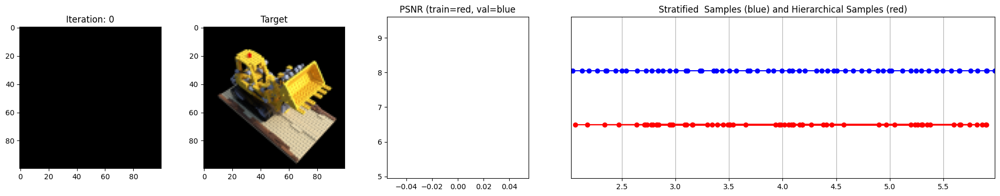

  0%|          | 99/100000 [00:43<12:14:24,  2.27it/s]


Val PSNR 9.391392707824707 below warmup_min_fitness 10.0. Stopping...


  0%|          | 0/100000 [00:00<?, ?it/s]

Loss: 0.18966397643089294


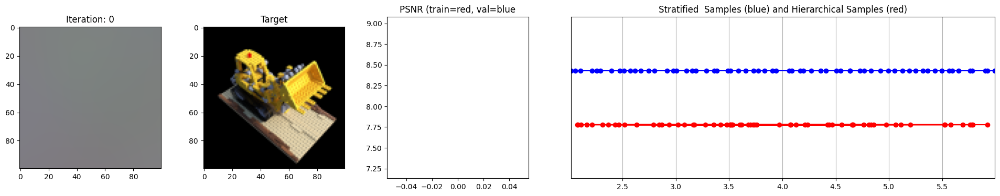

  1%|          | 1000/100000 [10:44<18:06:37,  1.52it/s]

Loss: 0.010132236406207085


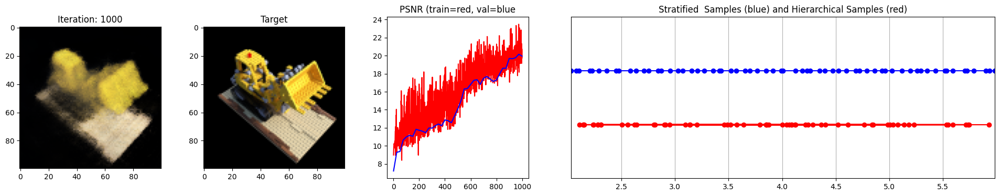

  2%|▏         | 2000/100000 [21:53<17:55:51,  1.52it/s]

Loss: 0.0062969401478767395


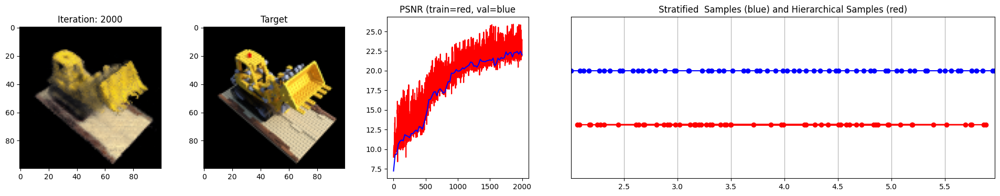

  3%|▎         | 3000/100000 [33:02<17:44:07,  1.52it/s]

Loss: 0.004550973419100046


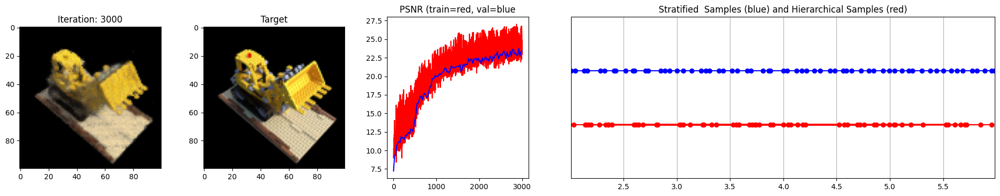

  4%|▍         | 4000/100000 [44:11<17:33:35,  1.52it/s]

Loss: 0.003916262183338404


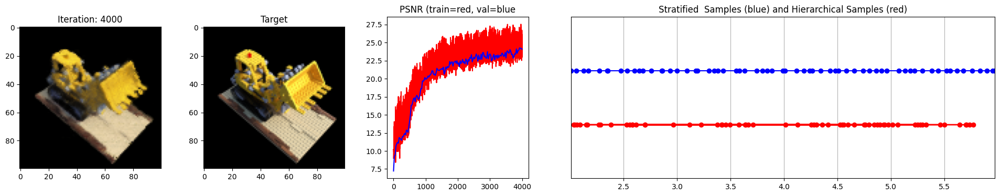

  5%|▌         | 5000/100000 [55:20<17:23:45,  1.52it/s]

Loss: 0.003941344562917948


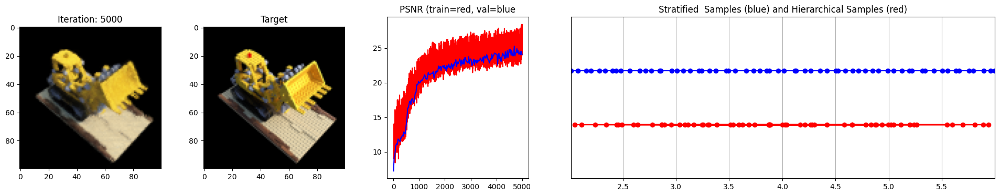

  6%|▌         | 6000/100000 [1:06:29<17:11:57,  1.52it/s]

Loss: 0.00384367979131639


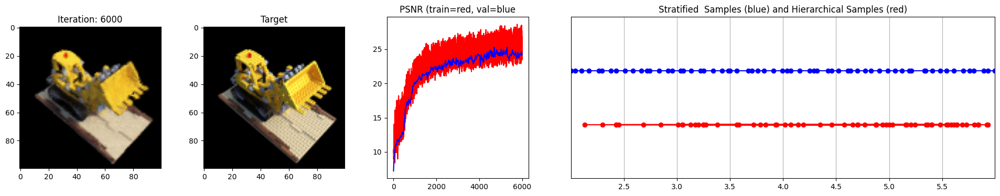

  7%|▋         | 7000/100000 [1:17:38<17:00:45,  1.52it/s]

Loss: 0.002880175830796361


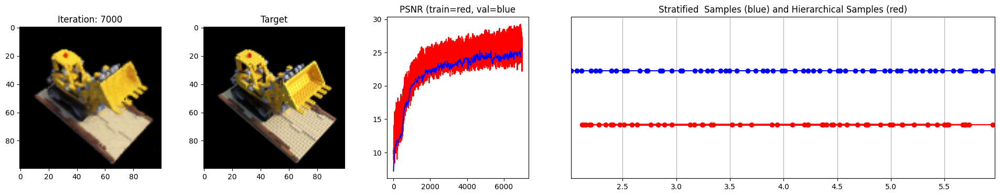

  8%|▊         | 8000/100000 [1:28:47<16:48:25,  1.52it/s]

Loss: 0.0031978352926671505


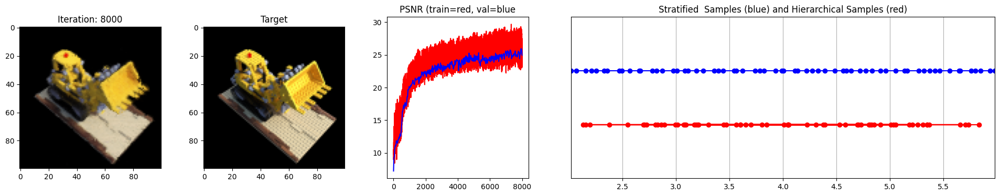

  9%|▉         | 9000/100000 [1:39:56<16:39:10,  1.52it/s]

Loss: 0.0035049794241786003


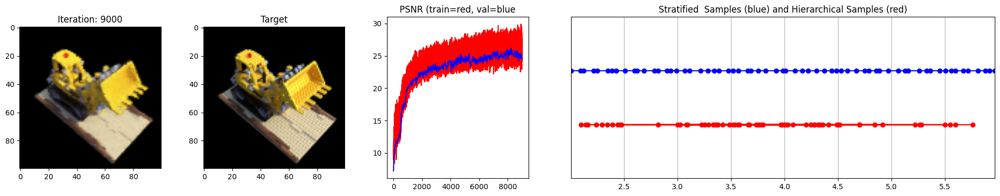

 10%|█         | 10000/100000 [1:51:05<16:29:01,  1.52it/s]

Loss: 0.003187829628586769


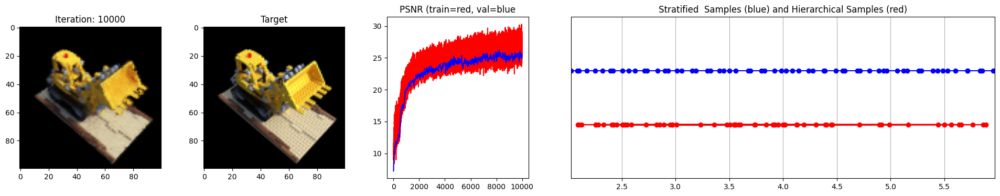

 11%|█         | 11000/100000 [2:02:14<16:17:53,  1.52it/s]

Loss: 0.002800010610371828


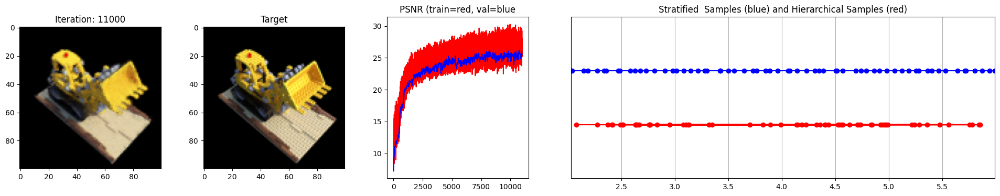

 12%|█▏        | 12000/100000 [2:13:23<16:06:15,  1.52it/s]

Loss: 0.0026673900429159403


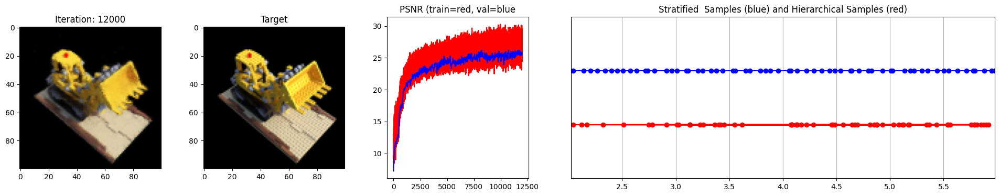

 13%|█▎        | 13000/100000 [2:24:32<15:55:38,  1.52it/s]

Loss: 0.0024442863650619984


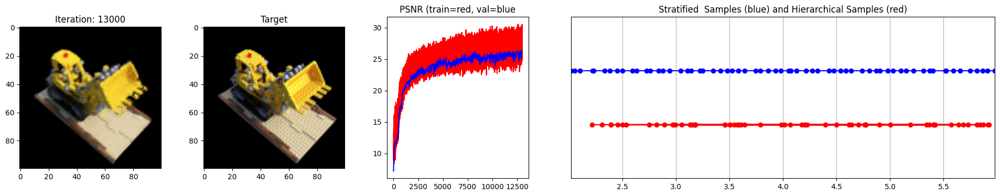

 14%|█▍        | 14000/100000 [2:35:41<15:45:43,  1.52it/s]

Loss: 0.0025671133771538734


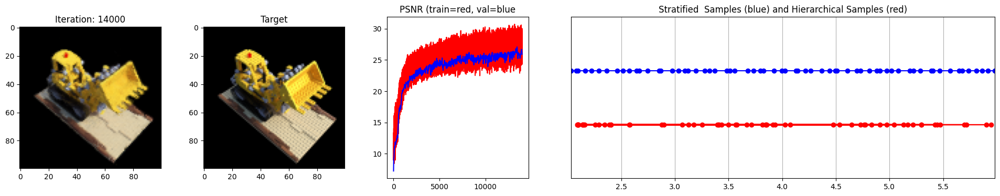

 15%|█▌        | 15000/100000 [2:46:51<15:34:06,  1.52it/s]

Loss: 0.0027958182618021965


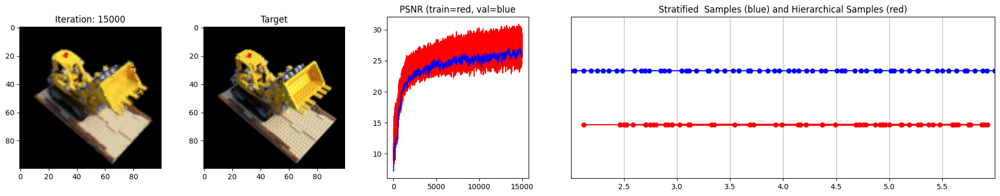

 16%|█▌        | 16000/100000 [2:58:00<15:22:44,  1.52it/s]

Loss: 0.0022567915730178356


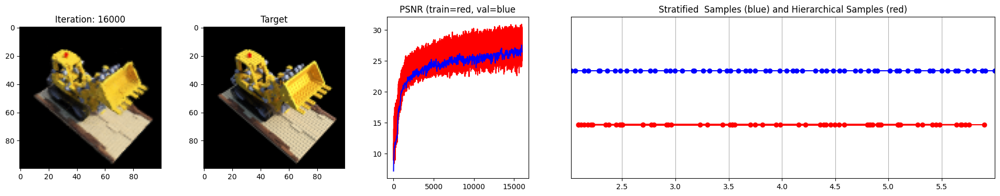

 17%|█▋        | 17000/100000 [3:09:09<15:11:14,  1.52it/s]

Loss: 0.0024231073912233114


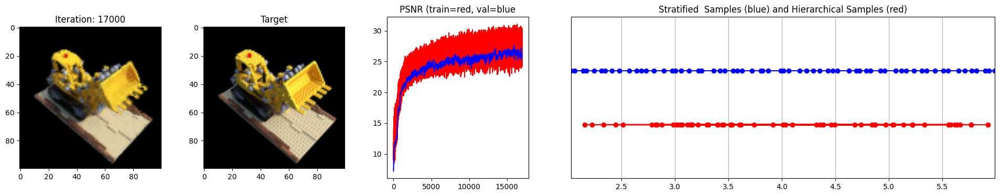

 18%|█▊        | 18000/100000 [3:20:18<15:01:11,  1.52it/s]

Loss: 0.0020679240114986897


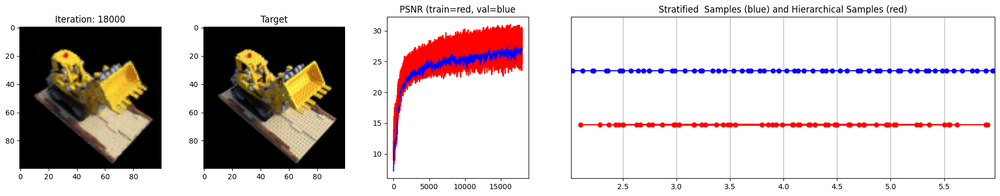

 19%|█▉        | 19000/100000 [3:31:27<15:03:57,  1.49it/s]

Loss: 0.0023936957586556673


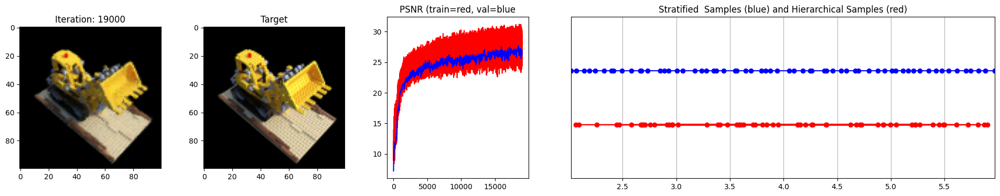

 20%|██        | 20000/100000 [3:42:36<14:38:16,  1.52it/s]

Loss: 0.002164373407140374


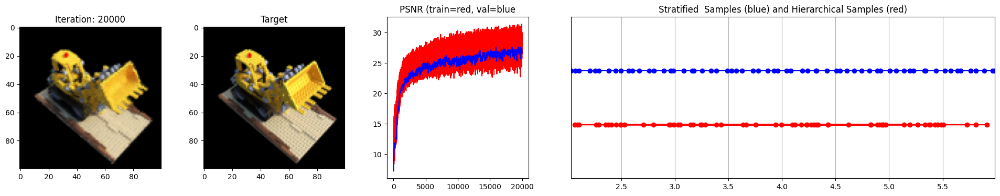

 21%|██        | 21000/100000 [3:53:45<14:30:05,  1.51it/s]

Loss: 0.002079600468277931


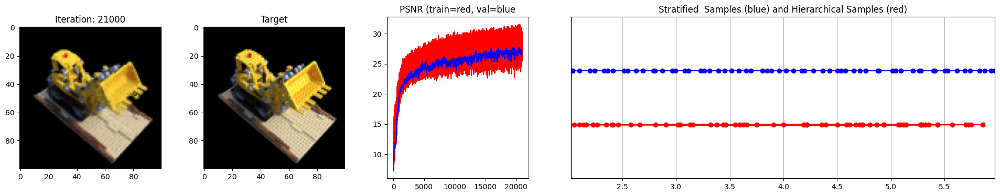

 22%|██▏       | 22000/100000 [4:04:54<14:16:57,  1.52it/s]

Loss: 0.0017392687732353806


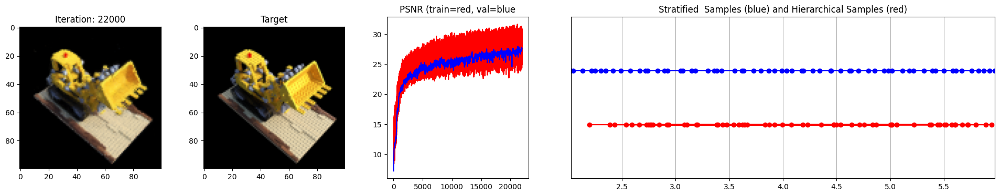

 23%|██▎       | 23000/100000 [4:16:03<14:05:49,  1.52it/s]

Loss: 0.0016042268835008144


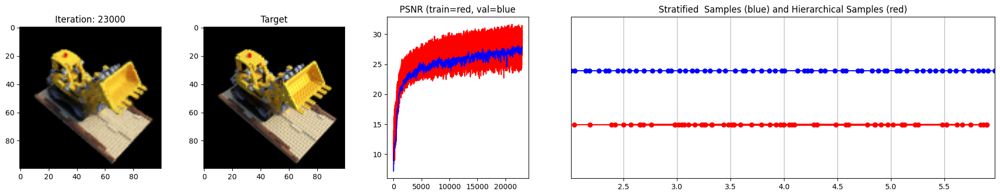

 24%|██▍       | 24000/100000 [4:27:13<13:54:48,  1.52it/s]

Loss: 0.0014063382986932993


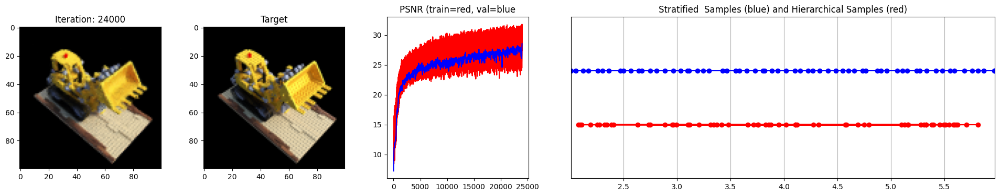

 25%|██▌       | 25000/100000 [4:38:22<13:43:07,  1.52it/s]

Loss: 0.0017473777988925576


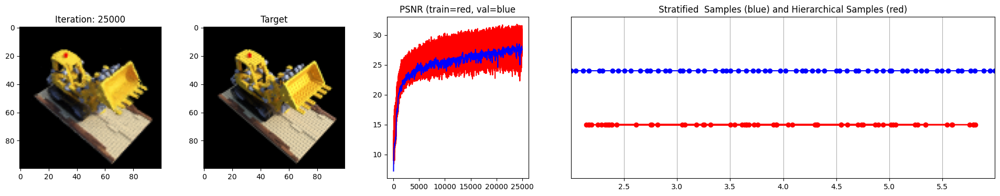

 26%|██▌       | 26000/100000 [4:49:31<13:32:38,  1.52it/s]

Loss: 0.0016959523782134056


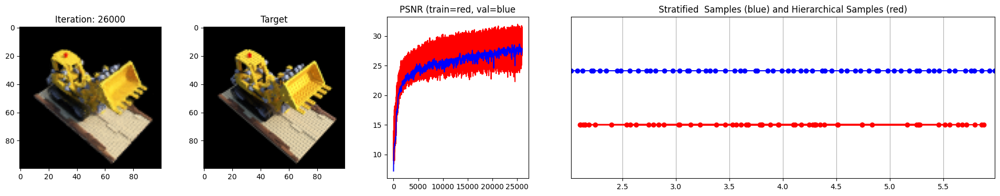

 27%|██▋       | 27000/100000 [5:00:40<13:21:34,  1.52it/s]

Loss: 0.0015269811265170574


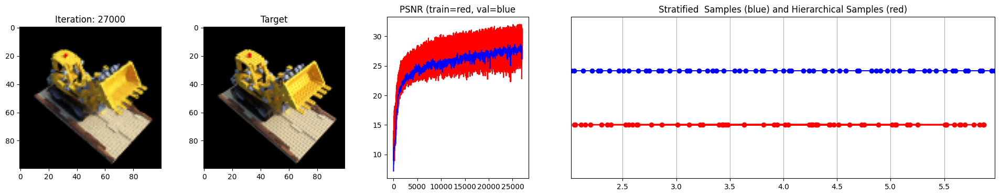

 28%|██▊       | 28000/100000 [5:11:49<13:09:40,  1.52it/s]

Loss: 0.001806408166885376


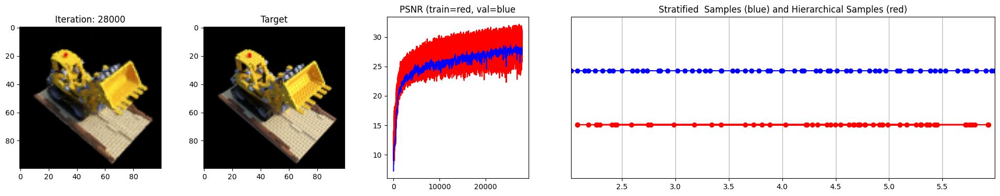

 29%|██▉       | 29000/100000 [5:22:59<12:59:20,  1.52it/s]

Loss: 0.0015433640219271183


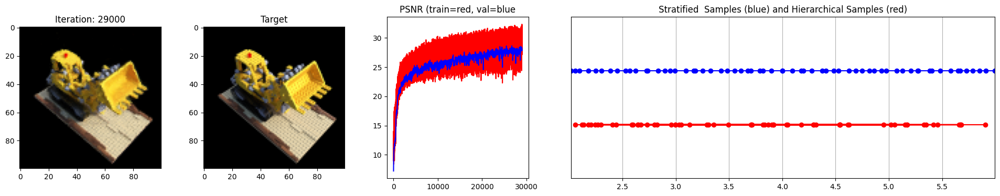

 30%|███       | 30000/100000 [5:34:08<12:49:27,  1.52it/s]

Loss: 0.0032146843150258064


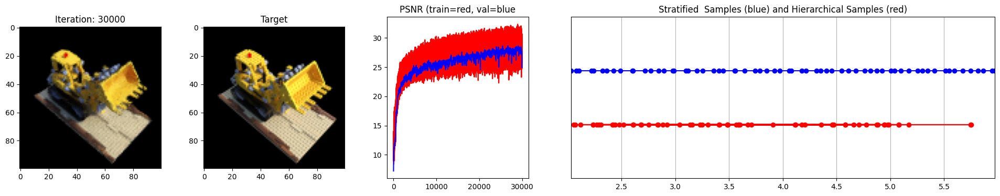

 31%|███       | 31000/100000 [5:45:17<12:37:52,  1.52it/s]

Loss: 0.0016747836489230394


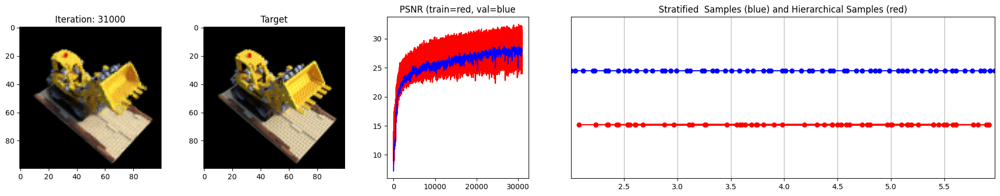

 32%|███▏      | 32000/100000 [5:56:26<12:26:46,  1.52it/s]

Loss: 0.001667268923483789


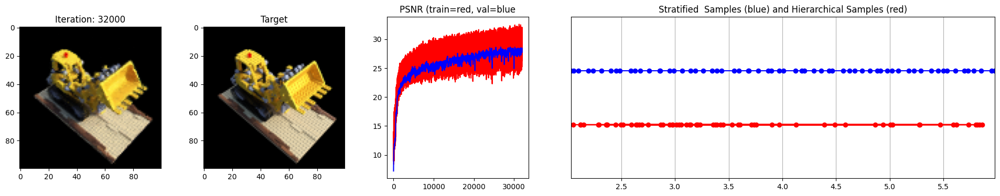

 33%|███▎      | 33000/100000 [6:07:35<12:17:01,  1.52it/s]

Loss: 0.0016315587563440204


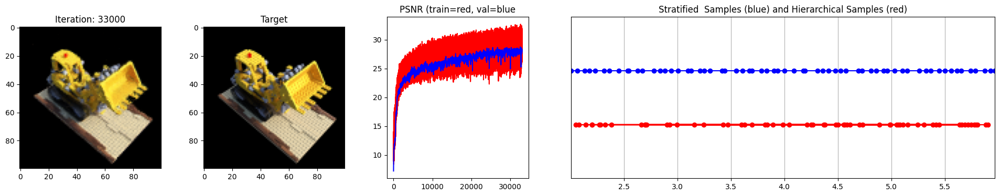

 34%|███▍      | 34000/100000 [6:18:44<12:05:02,  1.52it/s]

Loss: 0.0015596727607771754


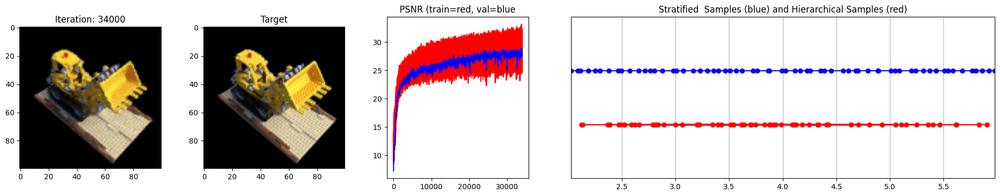

 35%|███▌      | 35000/100000 [6:29:53<11:54:16,  1.52it/s]

Loss: 0.0015607343520969152


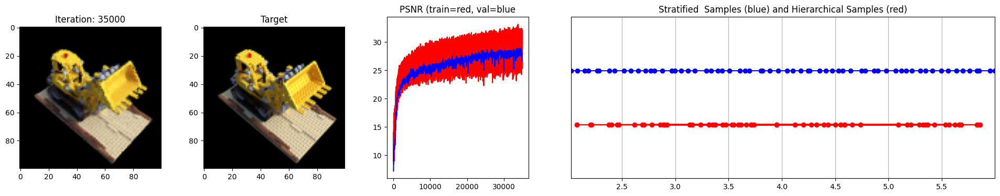

 36%|███▌      | 36000/100000 [6:41:03<11:43:02,  1.52it/s]

Loss: 0.0015436793910339475


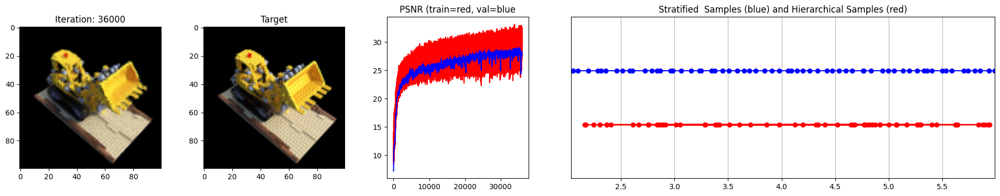

 37%|███▋      | 37000/100000 [6:52:12<11:31:40,  1.52it/s]

Loss: 0.0014461226528510451


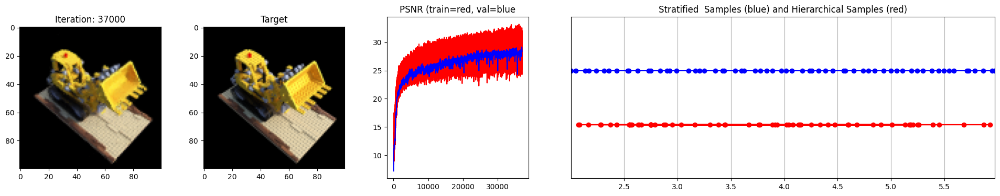

 38%|███▊      | 38000/100000 [7:03:21<11:20:15,  1.52it/s]

Loss: 0.001576932379975915


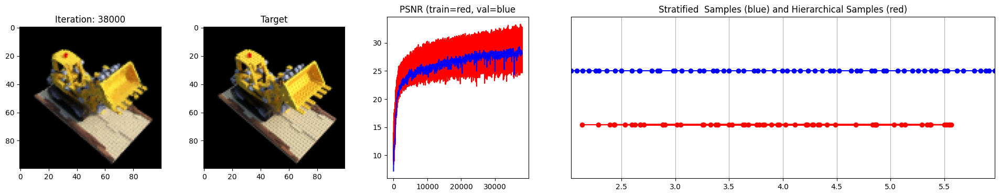

 39%|███▉      | 39000/100000 [7:14:31<11:09:50,  1.52it/s]

Loss: 0.0015415232628583908


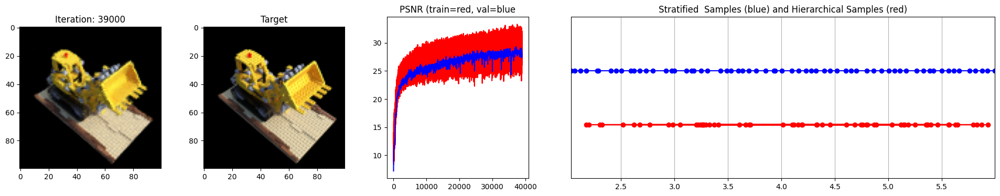

 40%|████      | 40000/100000 [7:25:40<10:58:37,  1.52it/s]

Loss: 0.0014195139519870281


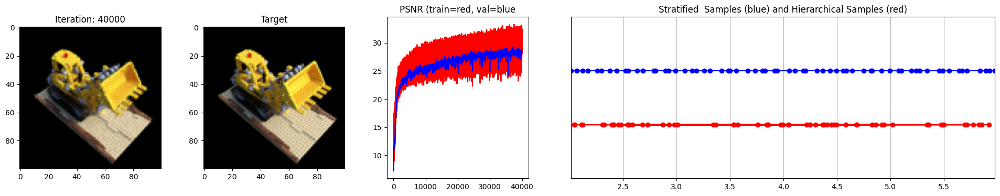

 41%|████      | 41000/100000 [7:36:49<10:47:36,  1.52it/s]

Loss: 0.001367660821415484


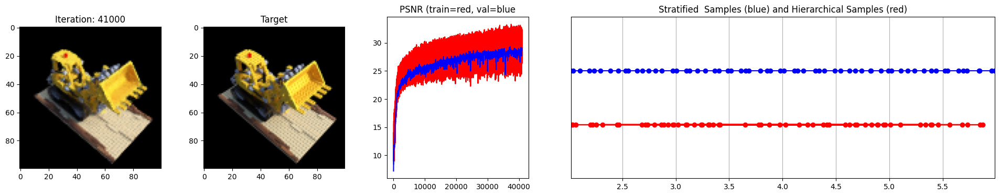

 42%|████▏     | 42000/100000 [7:47:58<10:37:01,  1.52it/s]

Loss: 0.0014066803269088268


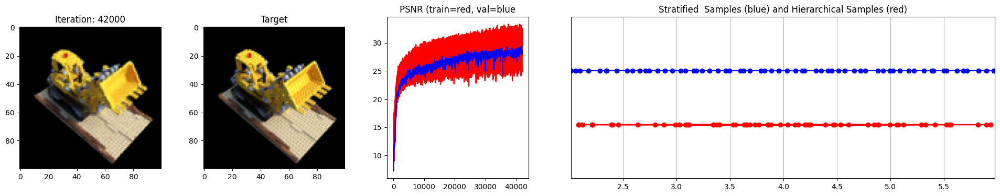

 43%|████▎     | 43000/100000 [7:59:07<10:25:31,  1.52it/s]

Loss: 0.0015127408551052213


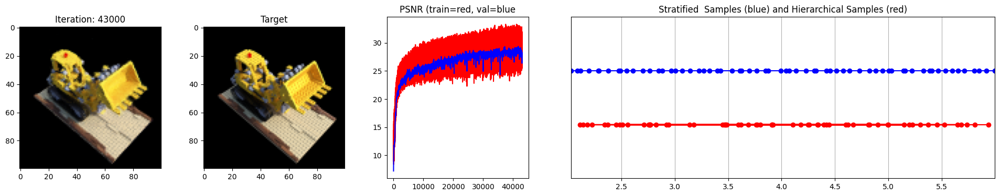

 44%|████▍     | 44000/100000 [8:10:16<10:14:48,  1.52it/s]

Loss: 0.0013303078012540936


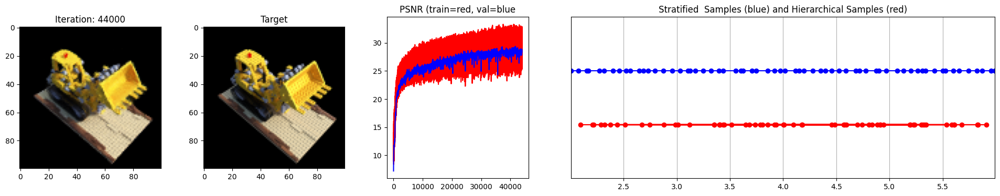

 45%|████▌     | 45000/100000 [8:21:25<10:04:00,  1.52it/s]

Loss: 0.0015632727881893516


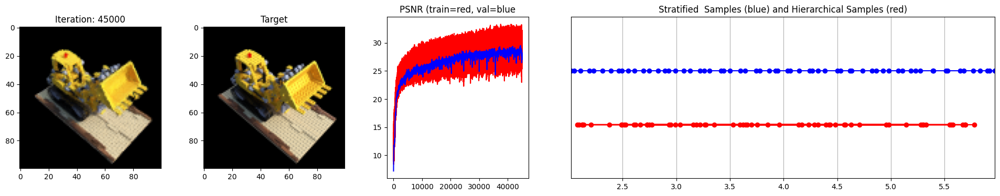

 46%|████▌     | 46000/100000 [8:32:34<9:53:06,  1.52it/s]

Loss: 0.0015623082872480154


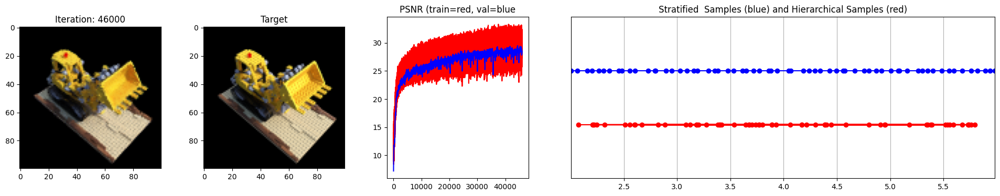

 47%|████▋     | 47000/100000 [8:43:44<9:42:01,  1.52it/s]

Loss: 0.0013257397804409266


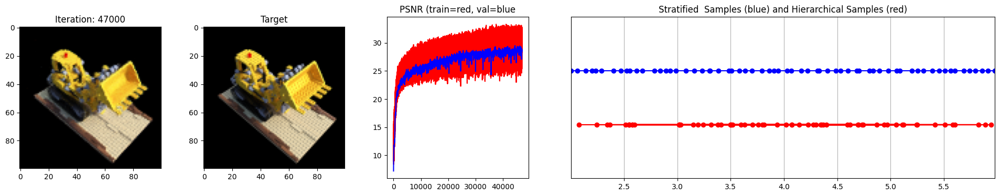

 48%|████▊     | 48000/100000 [8:54:53<9:30:41,  1.52it/s]

Loss: 0.0013173220213502645


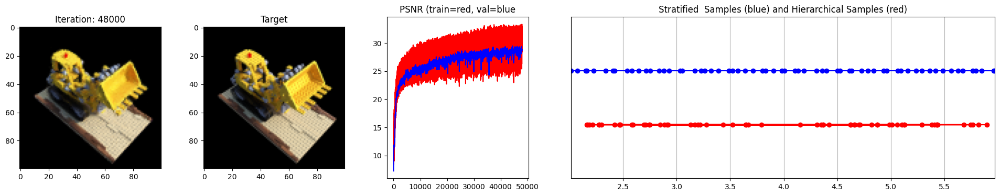

 49%|████▉     | 49000/100000 [9:06:02<9:20:05,  1.52it/s]

Loss: 0.001207128632813692


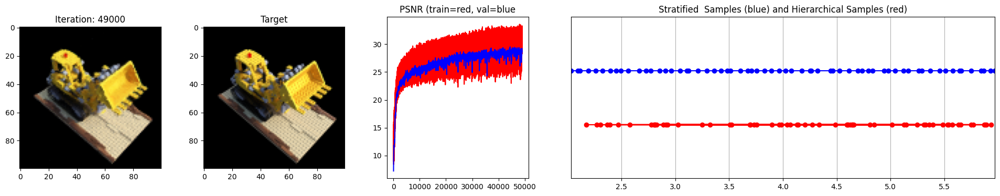

 50%|█████     | 50000/100000 [9:17:11<9:09:28,  1.52it/s]

Loss: 0.0012850591447204351


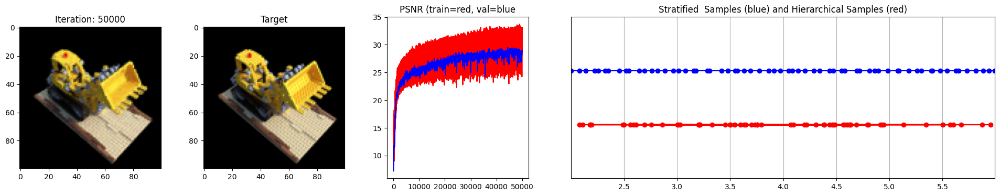

 51%|█████     | 51000/100000 [9:28:20<8:57:54,  1.52it/s]

Loss: 0.0011977499816566706


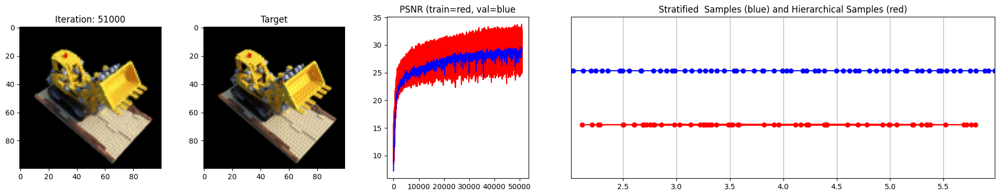

 52%|█████▏    | 52000/100000 [9:39:30<8:47:07,  1.52it/s]

Loss: 0.0012060803128406405


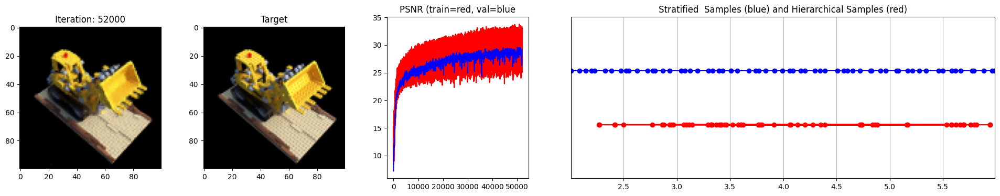

 53%|█████▎    | 53000/100000 [9:50:39<8:36:04,  1.52it/s]

Loss: 0.0012710961746051908


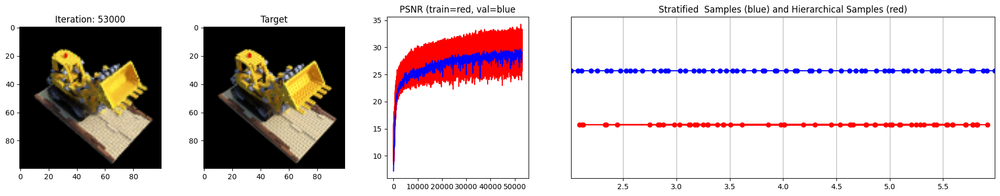

 54%|█████▍    | 54000/100000 [10:01:48<8:25:55,  1.52it/s]

Loss: 0.0015840037958696485


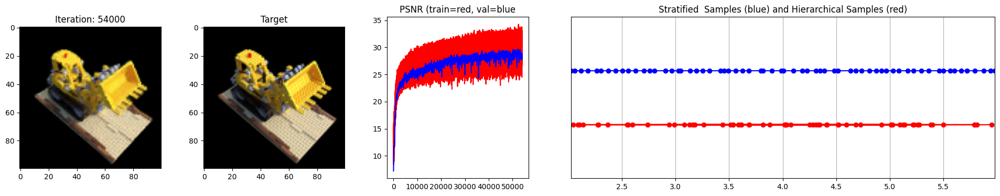

 55%|█████▌    | 55000/100000 [10:12:58<8:14:43,  1.52it/s]

Loss: 0.001433072960935533


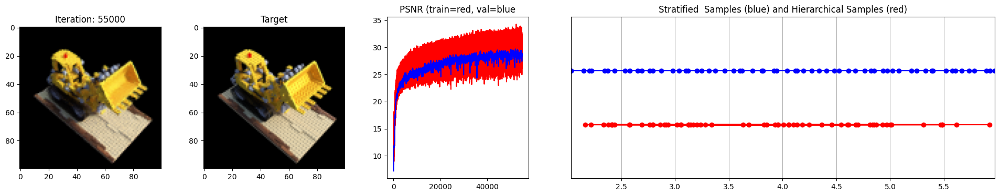

 56%|█████▌    | 56000/100000 [10:24:07<8:03:35,  1.52it/s]

Loss: 0.0015002824366092682


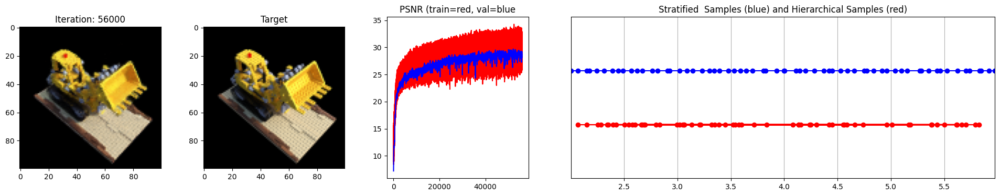

 57%|█████▋    | 57000/100000 [10:35:16<7:52:18,  1.52it/s]

Loss: 0.0017532712081447244


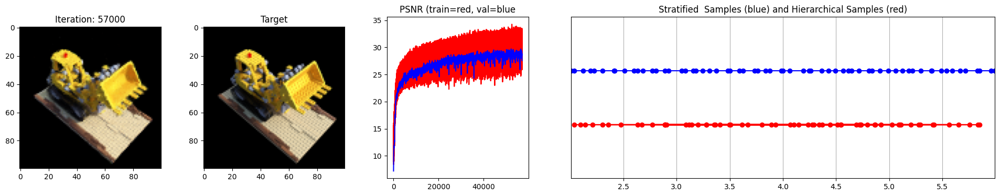

 58%|█████▊    | 58000/100000 [10:46:26<7:41:15,  1.52it/s]

Loss: 0.001230988884344697


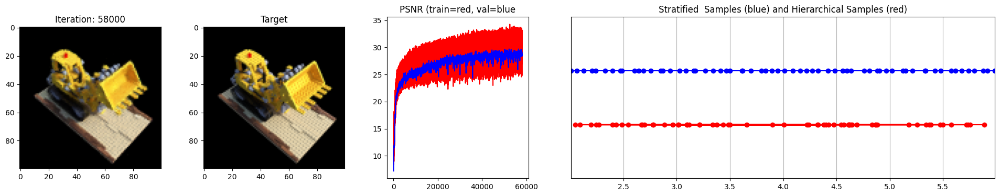

 59%|█████▉    | 59000/100000 [10:57:35<7:30:11,  1.52it/s]

Loss: 0.0014103965368121862


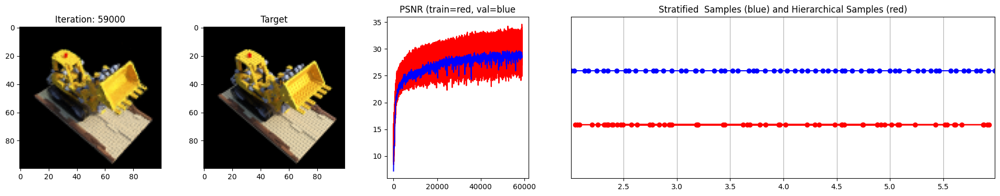

 60%|██████    | 60000/100000 [11:08:44<7:19:12,  1.52it/s]

Loss: 0.0011683793272823095


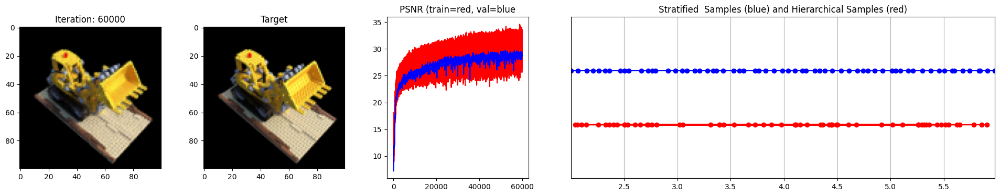

 61%|██████    | 61000/100000 [11:19:53<7:07:56,  1.52it/s]

Loss: 0.0012718008365482092


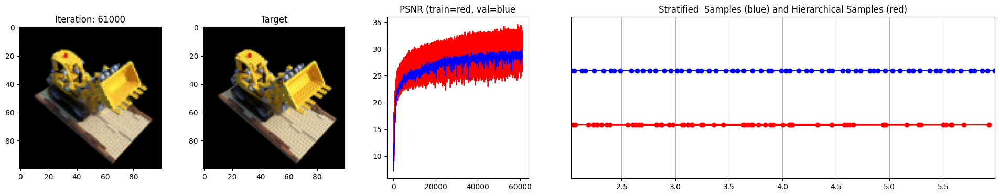

 62%|██████▏   | 62000/100000 [11:31:03<6:57:30,  1.52it/s]

Loss: 0.0014136215904727578


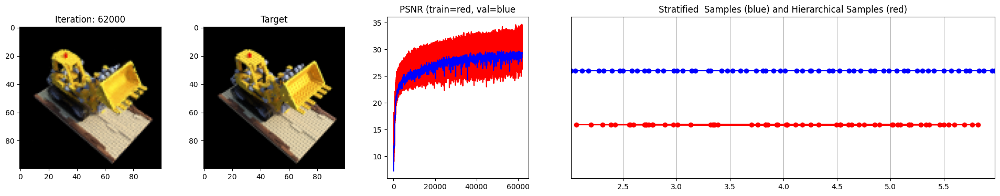

 63%|██████▎   | 63000/100000 [11:42:12<6:46:28,  1.52it/s]

Loss: 0.0012241301592439413


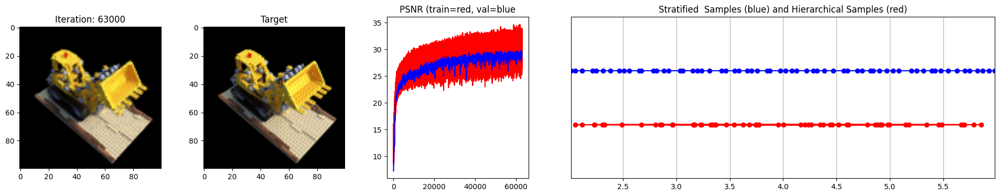

 64%|██████▍   | 64000/100000 [11:53:22<6:35:58,  1.52it/s]

Loss: 0.0014370392309501767


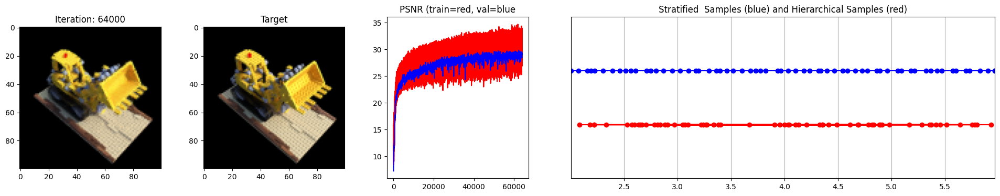

 65%|██████▌   | 65000/100000 [12:04:31<6:24:24,  1.52it/s]

Loss: 0.001283263205550611


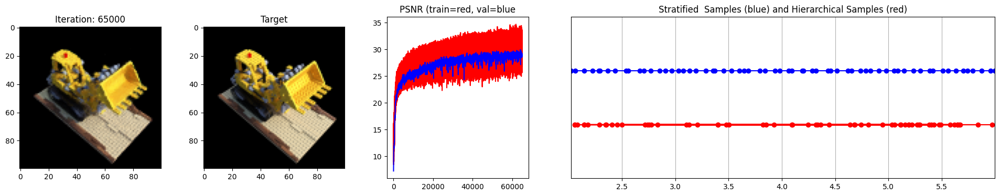

 66%|██████▌   | 66000/100000 [12:15:40<6:13:20,  1.52it/s]

Loss: 0.0013857302255928516


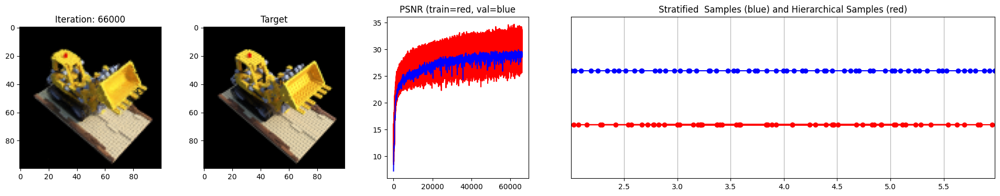

 67%|██████▋   | 67000/100000 [12:26:50<6:03:07,  1.51it/s]

Loss: 0.0012523208279162645


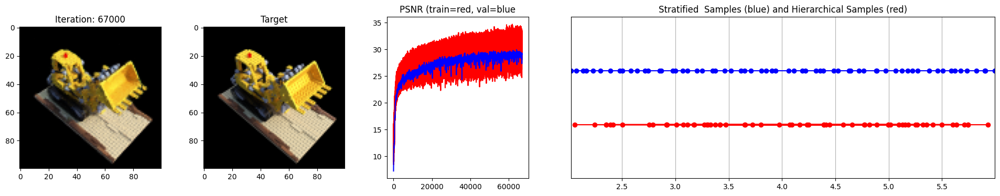

 68%|██████▊   | 68000/100000 [12:37:59<5:51:06,  1.52it/s]

Loss: 0.001408692100085318


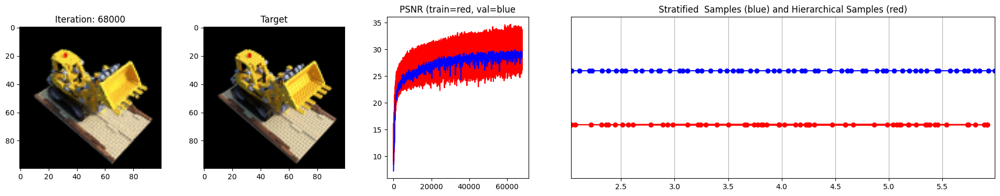

 69%|██████▉   | 69000/100000 [12:49:08<5:40:24,  1.52it/s]

Loss: 0.0012354120844975114


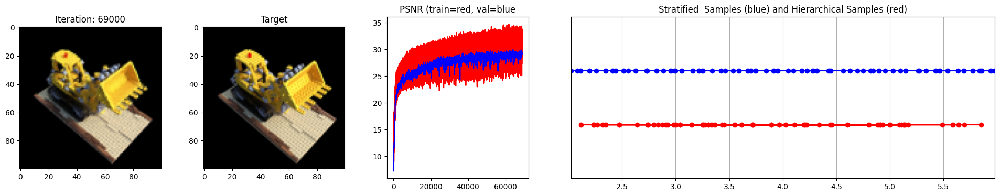

 70%|███████   | 70000/100000 [13:00:18<5:29:35,  1.52it/s]

Loss: 0.0014088257448747754


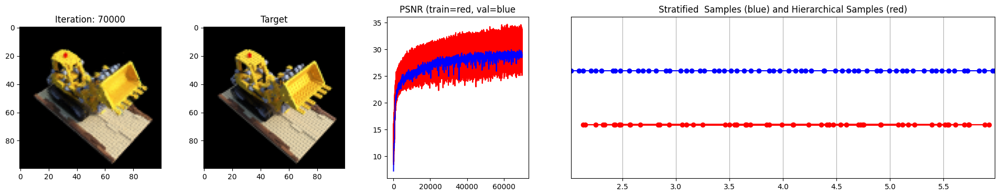

 71%|███████   | 71000/100000 [13:11:27<5:18:24,  1.52it/s]

Loss: 0.0010718535631895065


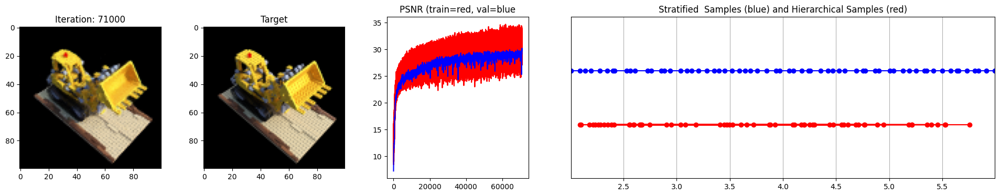

 72%|███████▏  | 72000/100000 [13:22:36<5:07:31,  1.52it/s]

Loss: 0.0012568534584715962


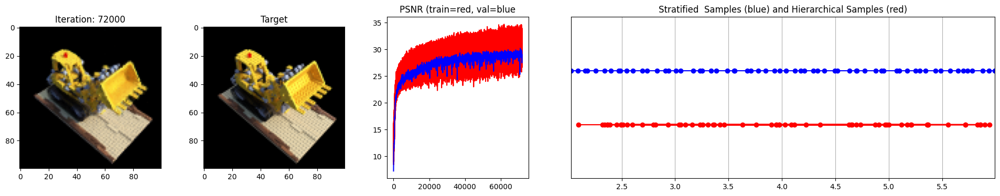

 73%|███████▎  | 73000/100000 [13:33:46<4:56:35,  1.52it/s]

Loss: 0.0010618966771289706


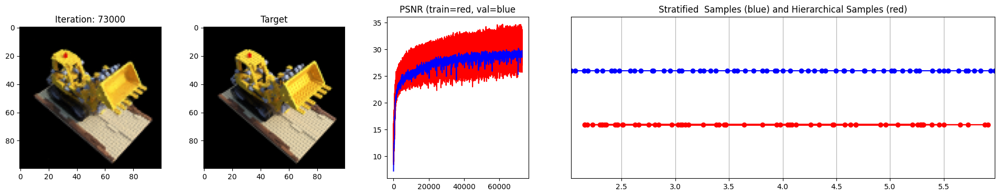

 74%|███████▍  | 74000/100000 [13:44:55<4:45:44,  1.52it/s]

Loss: 0.0022663772106170654


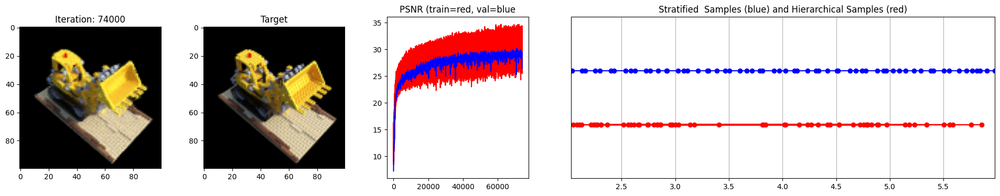

 75%|███████▌  | 75000/100000 [13:56:04<4:34:24,  1.52it/s]

Loss: 0.0012762873666360974


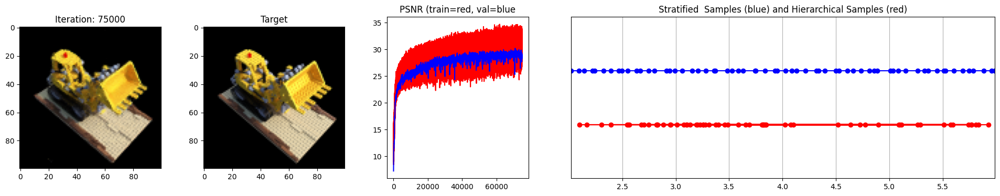

 76%|███████▌  | 76000/100000 [14:07:13<4:23:42,  1.52it/s]

Loss: 0.0013273513177409768


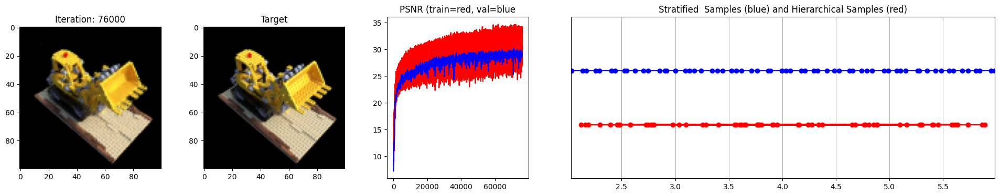

 77%|███████▋  | 77000/100000 [14:18:23<4:12:38,  1.52it/s]

Loss: 0.0011517530074343085


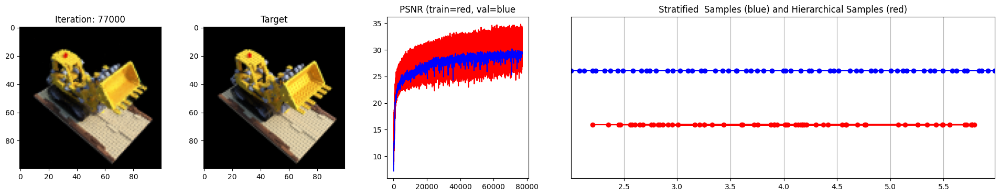

 78%|███████▊  | 78000/100000 [14:29:32<4:02:02,  1.51it/s]

Loss: 0.0013099343050271273


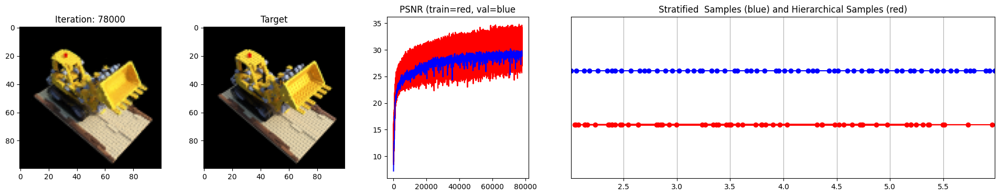

 79%|███████▉  | 79000/100000 [14:40:41<3:50:25,  1.52it/s]

Loss: 0.001209164154715836


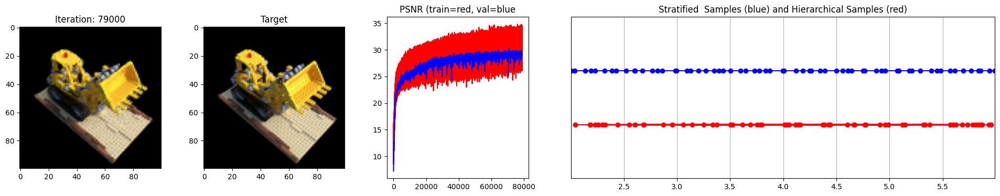

 80%|████████  | 80000/100000 [14:51:50<3:39:30,  1.52it/s]

Loss: 0.0012367661111056805


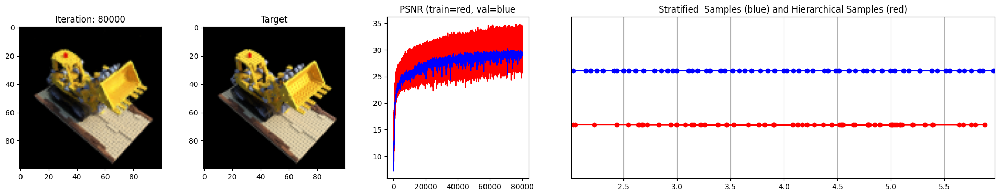

 81%|████████  | 80687/100000 [14:59:30<3:32:20,  1.52it/s]

In [ ]:
# Run training session(s)
for _ in range(n_restarts):
  model, fine_model, encode, encode_viewdirs, optimizer, warmup_stopper = init_models()
  success, train_psnrs, val_psnrs = train()
  if success and val_psnrs[-1] >= warmup_min_fitness:
    print('Training successful!')
    break

print('')
print(f'Done!')

  0%|          | 0/30000 [00:00<?, ?it/s]

Loss: 0.0010583919938653708


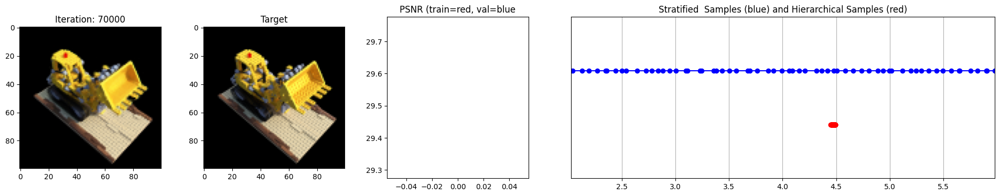

  3%|▎         | 1000/30000 [10:45<5:18:48,  1.52it/s]

Loss: 0.0010481744538992643


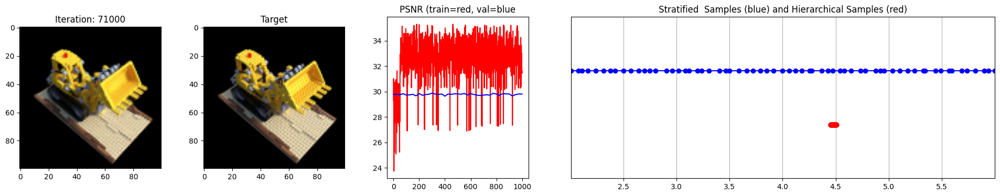

  7%|▋         | 2000/30000 [21:56<5:07:51,  1.52it/s]

Loss: 0.0010346322087571025


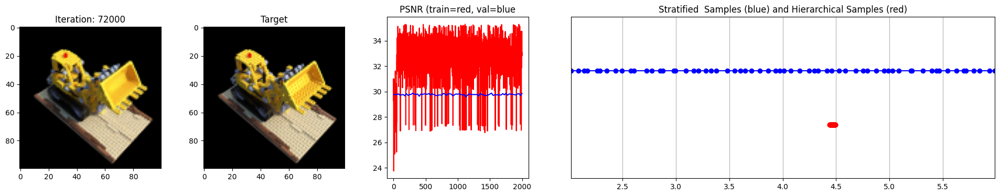

 10%|█         | 3000/30000 [33:07<4:57:23,  1.51it/s]

Loss: 0.001050423365086317


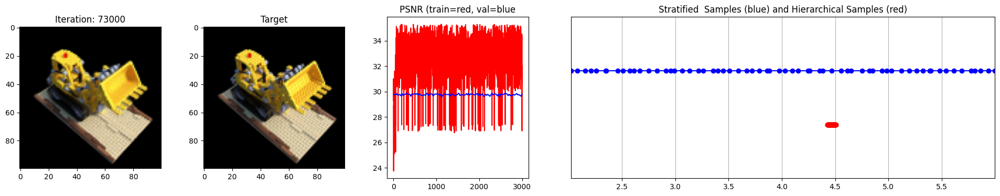

 13%|█▎        | 4000/30000 [44:18<4:45:34,  1.52it/s]

Loss: 0.001068150857463479


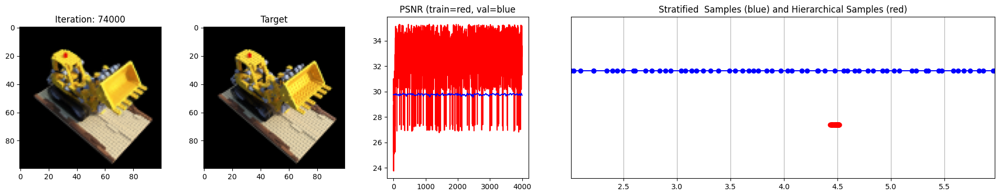

 17%|█▋        | 5000/30000 [55:27<4:34:46,  1.52it/s]

Loss: 0.0010514457244426012


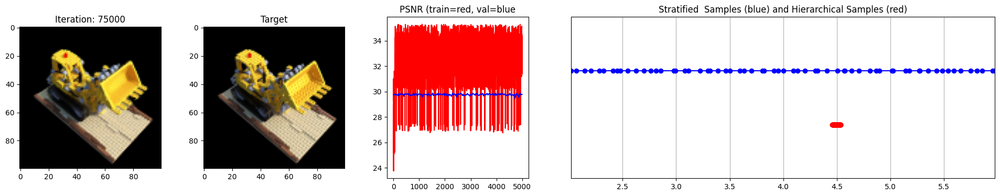

 20%|██        | 6000/30000 [1:06:37<4:23:54,  1.52it/s]

Loss: 0.0010536860208958387


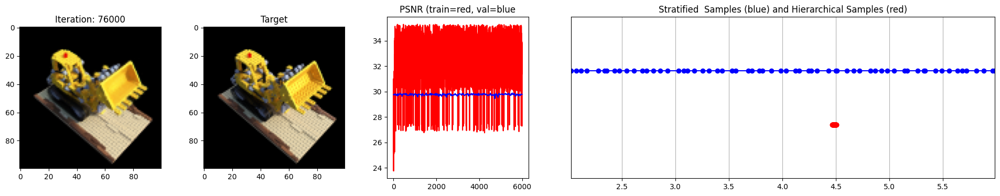

 23%|██▎       | 7000/30000 [1:17:47<4:12:32,  1.52it/s]

Loss: 0.0010672940406948328


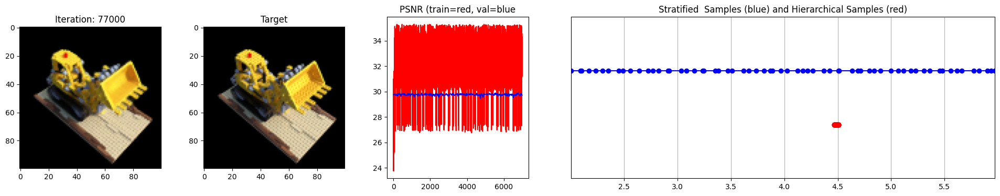

 27%|██▋       | 8000/30000 [1:28:56<4:01:38,  1.52it/s]

Loss: 0.001058038673363626


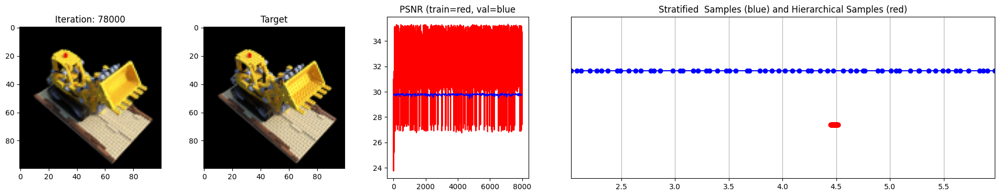

 30%|███       | 9000/30000 [1:40:06<3:50:44,  1.52it/s]

Loss: 0.0010606384603306651


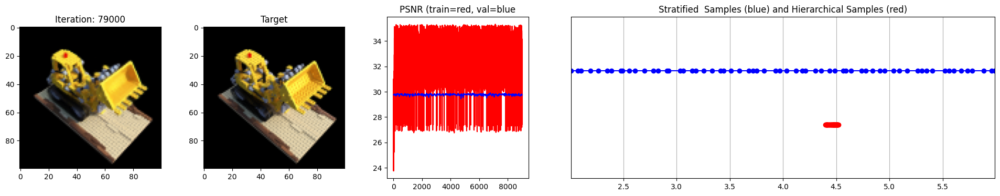

 33%|███▎      | 10000/30000 [1:51:16<3:39:44,  1.52it/s]

Loss: 0.0010730652138590813


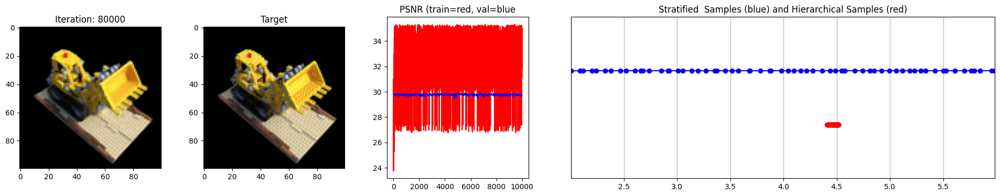

 37%|███▋      | 11000/30000 [2:02:25<3:28:47,  1.52it/s]

Loss: 0.0010545221157371998


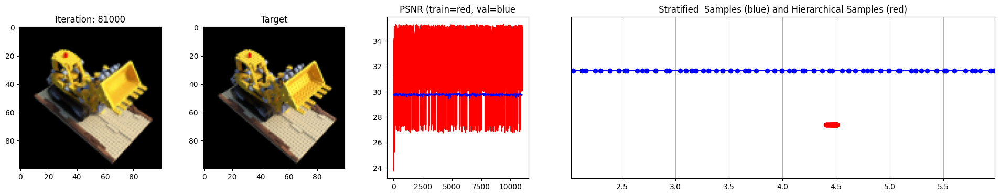

 40%|████      | 12000/30000 [2:13:35<3:17:43,  1.52it/s]

Loss: 0.001062641036696732


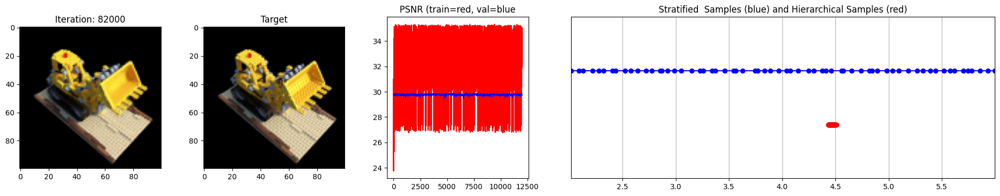

 43%|████▎     | 13000/30000 [2:24:45<3:06:51,  1.52it/s]

Loss: 0.0010736455442383885


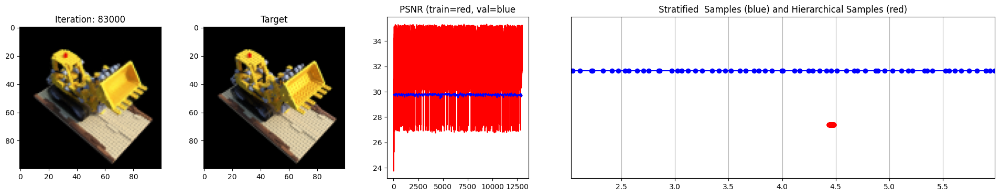

 47%|████▋     | 14000/30000 [2:35:55<2:55:48,  1.52it/s]

Loss: 0.001067533390596509


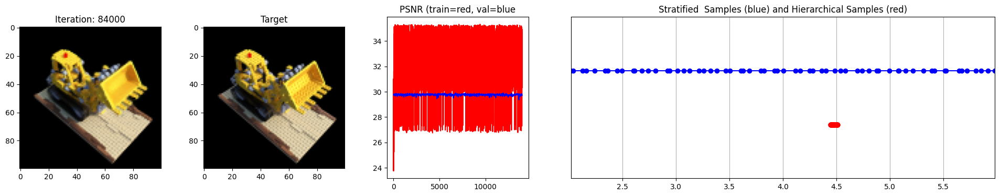

 50%|█████     | 15000/30000 [2:47:05<2:44:55,  1.52it/s]

Loss: 0.0010588446166366339


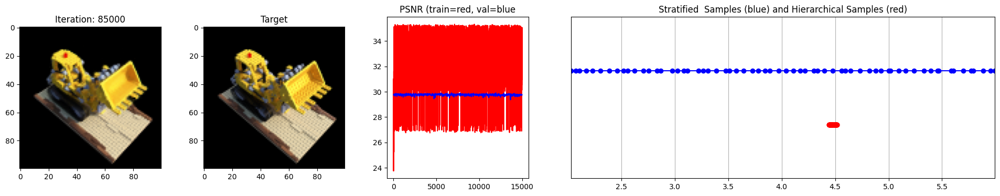

 53%|█████▎    | 16000/30000 [2:58:15<2:33:54,  1.52it/s]

Loss: 0.0010568900033831596


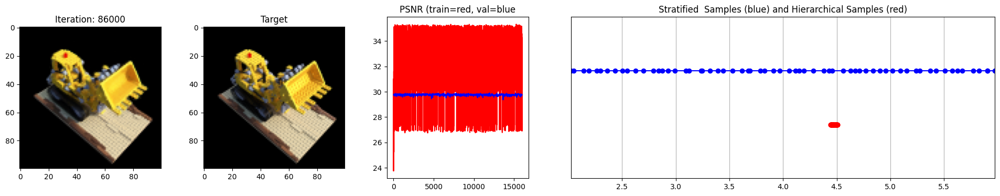

 57%|█████▋    | 17000/30000 [3:09:25<2:23:00,  1.52it/s]

Loss: 0.0010630873730406165


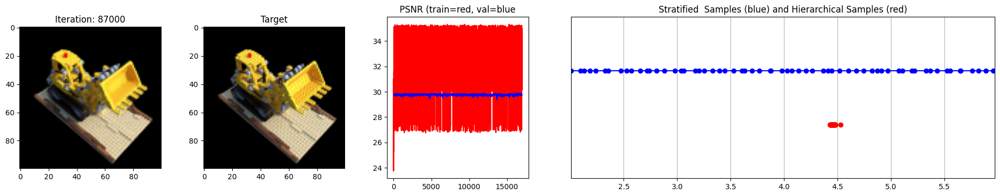

 60%|██████    | 18000/30000 [3:20:35<2:12:02,  1.51it/s]

Loss: 0.001061093877069652


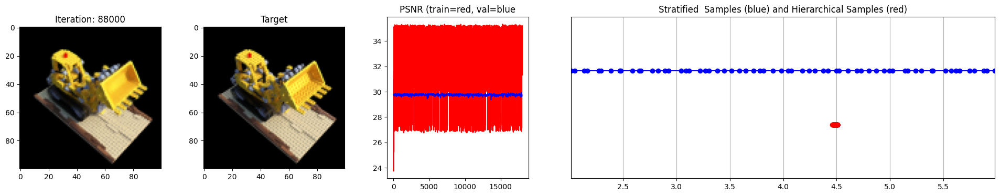

 63%|██████▎   | 19000/30000 [3:31:45<2:01:01,  1.51it/s]

Loss: 0.0010513555025681853


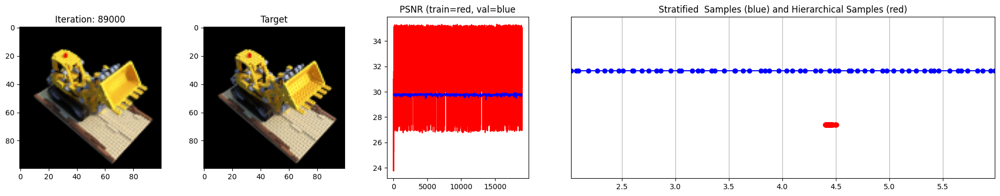

 67%|██████▋   | 20000/30000 [3:42:56<1:49:59,  1.52it/s]

Loss: 0.0010528741404414177


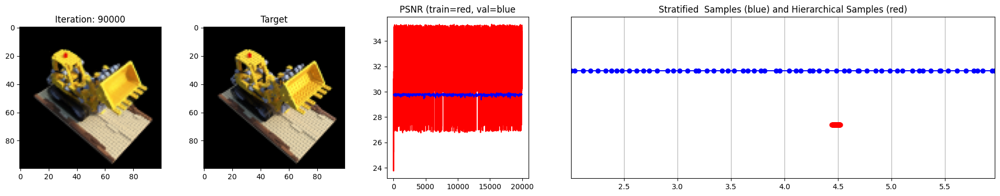

 70%|███████   | 21000/30000 [3:54:06<1:38:56,  1.52it/s]

Loss: 0.0010384704219177365


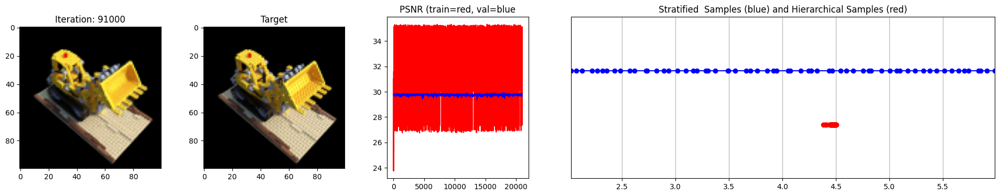

 73%|███████▎  | 22000/30000 [4:05:16<1:27:53,  1.52it/s]

Loss: 0.00107584276702255


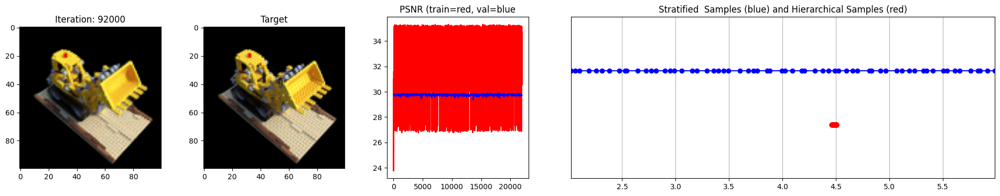

 77%|███████▋  | 23000/30000 [4:16:26<1:16:58,  1.52it/s]

Loss: 0.001062953844666481


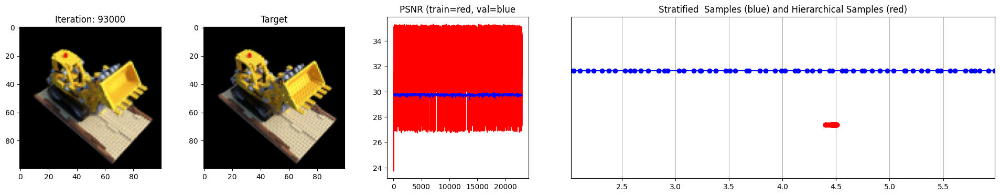

 80%|████████  | 24000/30000 [4:27:36<1:06:03,  1.51it/s]

Loss: 0.001060187234543264


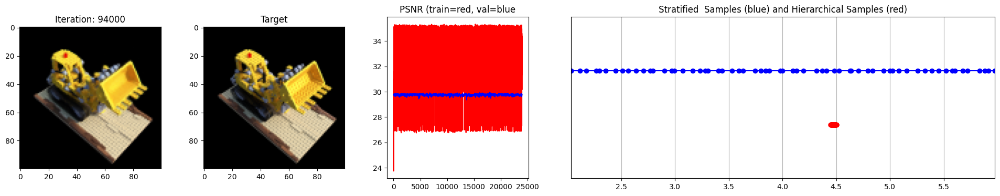

 83%|████████▎ | 25000/30000 [4:38:46<54:57,  1.52it/s]

Loss: 0.0010450065601617098


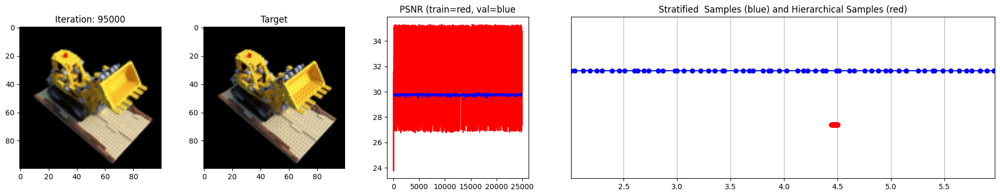

 87%|████████▋ | 26000/30000 [4:49:56<43:57,  1.52it/s]

Loss: 0.0010636691004037857


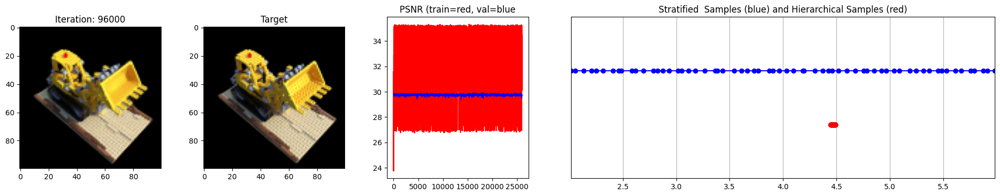

 90%|█████████ | 27000/30000 [5:01:07<32:57,  1.52it/s]

Loss: 0.0010415471624583006


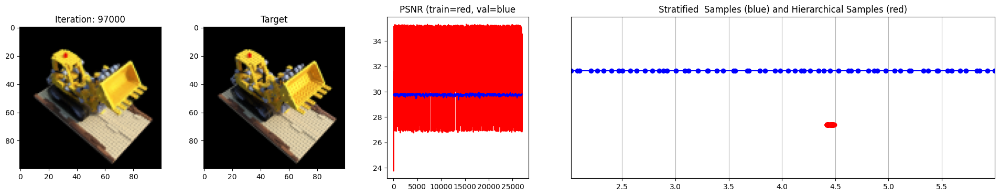

 93%|█████████▎| 28000/30000 [5:12:17<21:59,  1.52it/s]

Loss: 0.0010384002234786749


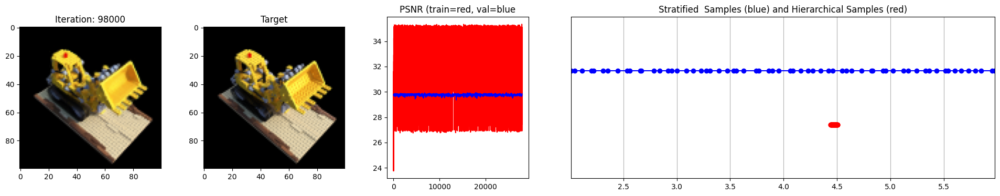

 97%|█████████▋| 29000/30000 [5:23:27<11:02,  1.51it/s]

Loss: 0.0010639851680025458


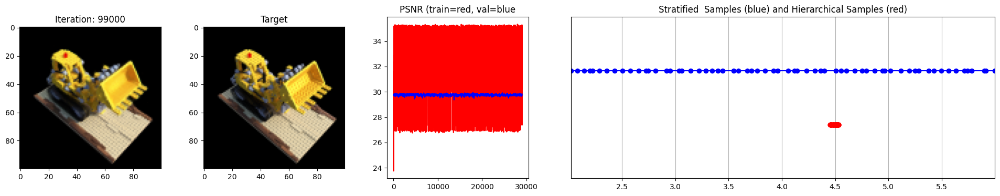

100%|█████████▉| 29999/30000 [5:34:37<00:00,  1.52it/s]

Loss: 0.0010563719552010298


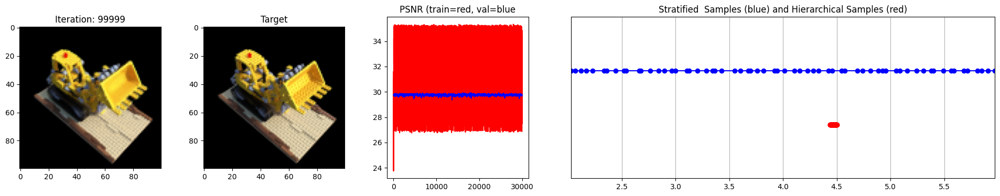

100%|██████████| 30000/30000 [5:34:38<00:00,  1.49it/s]

Training successful!

Done!


In [ ]:
# Continue training from checkpoint (in case of interruption)


# Load model
model, fine_model, encode, encode_viewdirs, optimizer, warmup_stopper = init_models()

model_state_dict = torch.load(drive_basedir + 'nerf-fine_70000.pt')
model = NeRF(encoder.d_output, n_layers=n_layers, d_filter=d_filter, skip=skip,
            d_viewdirs=model.d_viewdirs)
model.load_state_dict(model_state_dict)
model.to(device)

fine_model = model
fine_model.to(device)

success, train_psnrs, val_psnrs = train()
if success and val_psnrs[-1] >= warmup_min_fitness:
  print('Training successful!')

print('')
print(f'Done!')



In [ ]:
torch.save(model.state_dict(), drive_basedir+'nerf.pt')
torch.save(fine_model.state_dict(), drive_basedir+'nerf-fine.pt')

In [ ]:
# Plotting the loss curve
plt.plot(range(1, len(_TRAIN_LOSS) + 1), _TRAIN_LOSS, color='C0')
plt.title('Training Loss Curve')
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.legend()
plt.show()
print(f"Initial loss: {_TRAIN_LOSS[0]}")
print(f"Final loss: {_TRAIN_LOSS[-1]}")

In [ ]:
with open(drive_basedir+'_TRAIN_LOSS.txt', 'w') as f:
  for i in _TRAIN_LOSS:
    f.write("%s\n" % i)
print("DONE!")

In [ ]:
plt.plot(range(1, display_rate*len(_VAL_LOSS) + 1, display_rate), _VAL_LOSS, color='C1')
plt.title('Validation Loss Curve')
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.legend()
plt.show()
print(f"Initial loss: {_VAL_LOSS[0]}")
print(f"Final loss: {_VAL_LOSS[-1]}")

In [ ]:
with open(drive_basedir+'_VAL_LOSS.txt', 'w') as f:
  for i in _VAL_LOSS:
    f.write("%s\n" % i)
print("DONE!")

In [ ]:
plt.plot(range(1, display_rate*len(_TRAIN_LOSS[::display_rate]) + 1, display_rate), _TRAIN_LOSS[::display_rate], color='C0', label='Training')
plt.plot(range(1, display_rate*len(_VAL_LOSS) + 1, display_rate), _VAL_LOSS, color='C1', label='Validation')
plt.title('Loss Curve')
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.legend()
plt.show()

Loss: 0.0010387386428192258
Loss: 0.0010387386428192258


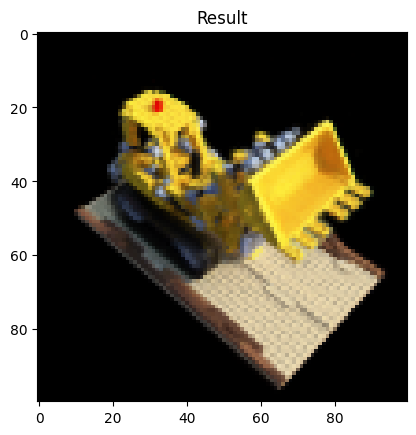

In [ ]:
# Load model
model, fine_model, encode, encode_viewdirs, optimizer, warmup_stopper = init_models()

model_state_dict = torch.load(drive_basedir + 'nerf-fine.pt')
model = NeRF(encoder.d_output, n_layers=n_layers, d_filter=d_filter, skip=skip,
            d_viewdirs=model.d_viewdirs)

model.load_state_dict(model_state_dict)
model.to(device)

fine_model = model
fine_model.to(device)

# Eval/Test model (change variables for our test image)
model.eval()
height, width = testimg.shape[:2]
rays_o, rays_d = get_rays(height, width, focal, testpose)
rays_o = rays_o.reshape([-1, 3])
rays_d = rays_d.reshape([-1, 3])
outputs = nerf_forward(rays_o, rays_d,
                        near, far, encode, model,
                        kwargs_sample_stratified=kwargs_sample_stratified,
                        n_samples_hierarchical=n_samples_hierarchical,
                        kwargs_sample_hierarchical=kwargs_sample_hierarchical,
                        fine_model=fine_model,
                        viewdirs_encoding_fn=encode_viewdirs,
                        chunksize=chunksize)

rgb_predicted = outputs['rgb_map']
_loss = torch.nn.functional.mse_loss(rgb_predicted, testimg.reshape(-1, 3))
print("Loss:", _loss.item())


# Plot output
print("Loss:", _loss.item())
plt.imshow(rgb_predicted.reshape([height, width, 3]).detach().cpu().numpy())
plt.title(f'Result')

plt.show()